# FLEX scRNA pilot
## Annotation
- Author: Jacopo Umberto Verga, Kane Foster
- Date: 25/March/2025


After combining FLEX/5' data, we are going to label these clusters depending on the expressed markers

## Prep

In [1]:
import os
import anndata as ad
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [71]:
marker_genes_dict = {
    'T cell': ['CD3D','CD3G','CD3E'],
    'NK':['KLRD1','NKG7','NCR1','FCGR3A','GNLY'],
    'ILC':['NKG7', 'CD7', 'KLRB1'],
    'Monocytes': ['FCN1','FCGR3A','IL1B','FCER1G','PSAP'],
    'Mac':['C1QA','CD68','APOE'],
    'cDC': ['FCER1A', 'CST3'],
    'pDC':['IRF8','GZMB'],
    'Platelet':['PPBP','PF4','CLU'],
    'B cell': ['CD79A','MS4A1','MZB1','CD19'],
    'PC': ['SDC1','SSR4','MZB1'],
    'MHCII':['CD74','HLA-DRA','HLA-DRB1'],
    'Prolif':['TYMS','MKI67','STMN1','HMGB2'],
    'ISG':['ISG15'],
    'HSC':['CD34','SPINK2','SERPINB1'],
    'Osteolineage':['THBD', 'CD36'],
    'MSC':['CXCL12', 'LEPR', 'COL3A1', 'APOE', 'CFD'],
    'RBC':['HBB','HBA1','HBA2'],
    'QC':['MALAT1','JUN','JUNB','FOS','FOSB','pct_counts_ig','doublet_scores','Scrublet_score','SCDS_hybrid_score','scDblFinder_score',]
}

In [151]:
# Unique phenotypes

ph = pd.read_csv('../data/phenotypes.csv')
ph.pheno1.nunique()

9

In [160]:
ph1_col = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22']

## Bandyopadhyay 2024 phenotypes

In [45]:
Bandyo_major = {
    'haemato':['PTPRC','MZB1'],
    'VSMC':['ACTA2','RGS2','TAGLN'],
    'EC':['CDH5','PECAM1','VWF'],
    'mesen':['CXCL12','PDGRFA']
}

DEG gene signatures
* Filtering for presence in FLEX?
* Will be a 5' bias due to more gene detection / higher expression?

In [3]:
TableS2 = pd.read_excel('../data/Bandyopadhyay-2024-TableS2.xlsx')
TableS2.head(2)

,gene,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster
0,NRXN3,1.515003e-159,3.866797,0.974,0.150,4.461986e-155,Adipo-MSC
1,NAV2,4.056904e-153,3.400635,0.987,0.225,1.194839e-148,Adipo-MSC


In [17]:
TableS2.cluster.unique()

array(['Adipo-MSC', 'AEC', 'APOD+ MSC', 'Ba/Eo/Ma', 'CD4+ T-Cell',
       'CD8+ T-Cell', 'CLP', 'Cycling DCs', 'Cycling HSPC',
       'Early Myeloid Progenitor', 'Erythroblast', 'Fibro-MSC', 'GMP',
       'HSC', 'Late Erythroid', 'Late Myeloid', 'Macrophages', 'Mature B',
       'Megakaryocyte', 'MEP', 'Monocyte', 'MPP', 'Neutrophil',
       'Osteoblast', 'Osteo-MSC', 'pDC', 'Plasma Cell', 'Pre-B',
       'Pre-Pro B', 'Pro-B', 'RBC', 'RNAlo MSC', 'SEC', 'THY1+ MSC',
       'VSMC'], dtype=object)

In [74]:
Bandyo_signatures = {}

for c in TableS2['cluster'].unique():
    Bandyo_signatures[c] = TableS2[TableS2['cluster']==c].sort_values('p_val_adj')['gene'].to_list()[:50]

Bandyo_signatures['AEC'][:3]

['IFI27', 'RAMP2', 'A2M']

## 5' samples

### Phenotyping

In [115]:
adata_5prime = sc.read('../out/single_cell_object/adata_5prime_clean.h5ad')

In [116]:
# Attach srublet

scr_df = []
for s in adata_5prime.obs.sample_id.unique():
    df = pd.read_csv('../out/'+s+'/Scrublet/'+s+'_Scrublet_results.csv').rename({'Cell':'og_barcodes'},axis=1)
    df['sample_id'] = s
    scr_df.append(df)
scr_df = pd.concat(scr_df)

adata_5prime.obs = adata_5prime.obs.reset_index(
    ).merge(scr_df, how="left", on=['og_barcodes','sample_id']).set_index('index')

In [120]:
adata_5prime

AnnData object with n_obs × n_vars = 171056 × 36601
    obs: 'og_barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_ig', 'log1p_total_counts_ig', 'pct_counts_ig', 'sample_id', 'thr', 'retrieve_mt', 'leiden', 'doublet_scores', 'predicted_doublets'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

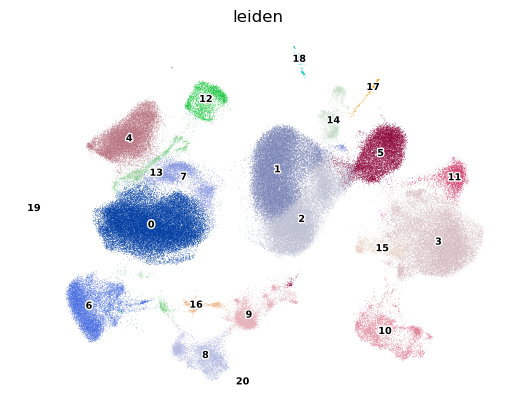

In [121]:
sc.pl.embedding(adata_5prime, basis="X_umap",frameon=False,ncols=3,color=["leiden",],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='x-small')

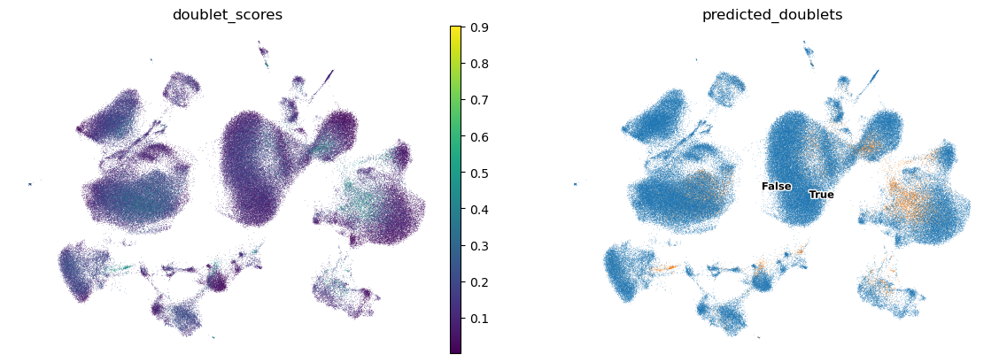

In [122]:
sc.pl.embedding(adata_5prime, basis="X_umap",frameon=False,ncols=3,
    color=['doublet_scores', 'predicted_doublets'],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='small')

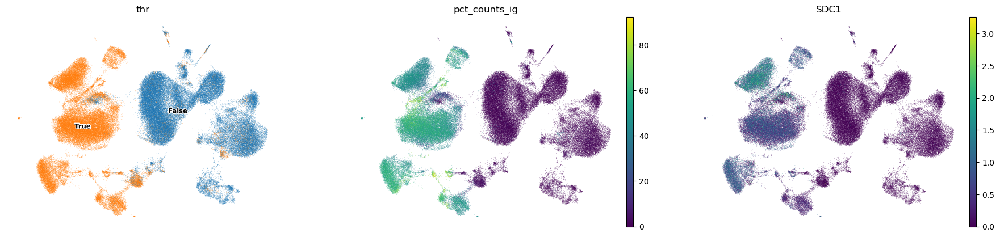

In [123]:
sc.pl.embedding(adata_5prime, basis="X_umap",frameon=False,ncols=3,color=["thr",'pct_counts_ig','SDC1'],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='small')

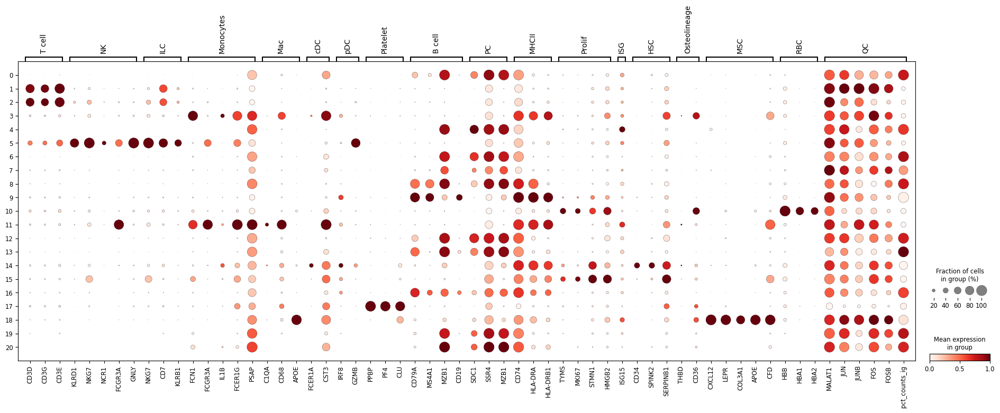

In [72]:
# Marker genes

marker_genes_dict_pl = marker_genes_dict.copy()
for k,v in marker_genes_dict_pl.items():
    marker_genes_dict_pl[k] = [g for g in v if g in  adata.var_names.to_list() + adata.obs.columns.to_list()  ]

sc.pl.dotplot(adata_5prime, marker_genes_dict_pl,'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

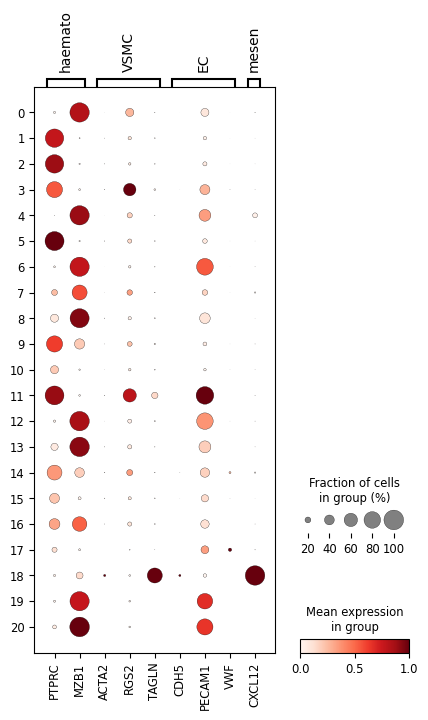

In [73]:
# Bandyo genes

Bandyo_major_pl = Bandyo_major.copy()
for k,v in Bandyo_major_pl.items():
    Bandyo_major_pl[k] = [g for g in v if g in  adata.var_names.to_list() + adata.obs.columns.to_list()  ]

sc.pl.dotplot(adata_5prime, Bandyo_major_pl, 'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

In [ ]:
# Bandyo signatures

In [125]:
for k,v in Bandyo_signatures.items():
    sc.tl.score_genes(adata_5prime,v,score_name=k+'_score')

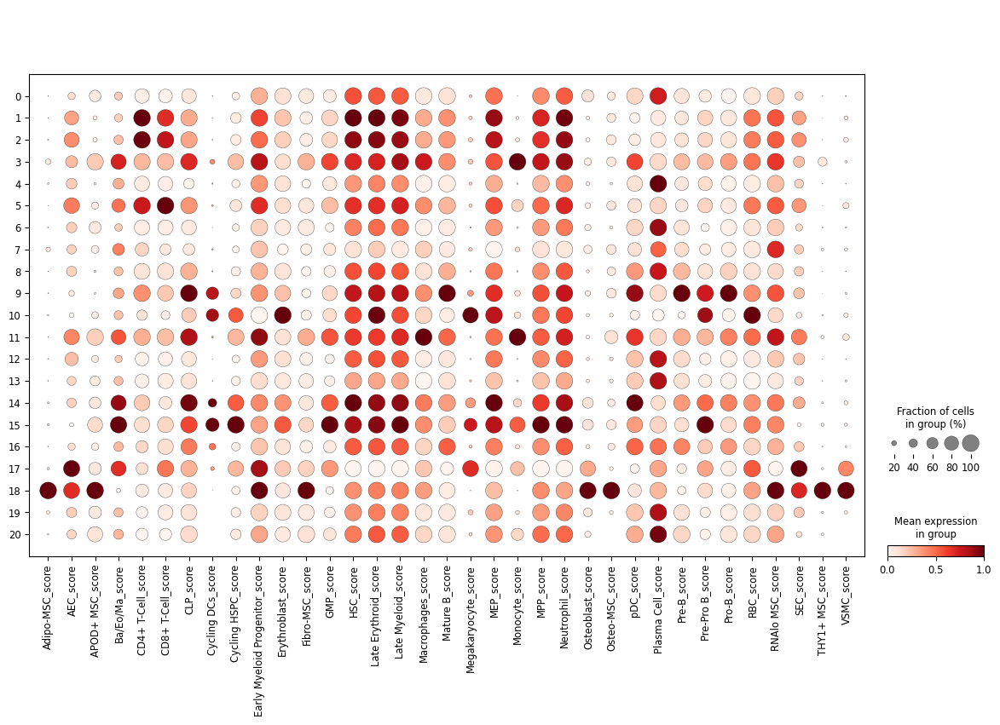

In [126]:
sc.pl.dotplot(adata_5prime, [i+'_score' for i in Bandyo_signatures.keys()], 'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

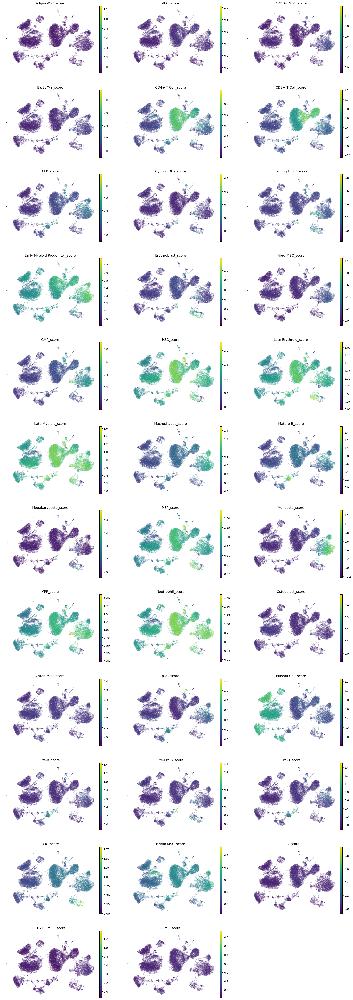

In [127]:
sc.pl.embedding(adata_5prime, basis="X_umap",frameon=False,ncols=3,
                color=[i+'_score' for i in Bandyo_signatures.keys()],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='x-small')

### Labelling

In [134]:
ph = pd.read_csv('../data/phenotypes.csv')
ph=ph[ph.modality=='fiveprime']
ph.leiden=ph.leiden.astype(str)
ph.head(2)

,modality,leiden,pheno1,pheno2
17,fiveprime,0,PC,PC
18,fiveprime,1,Lymphoid,Tcell


In [136]:
adata_5prime.obs = adata_5prime.obs.reset_index().merge(ph, how="left", on='leiden').set_index('index')

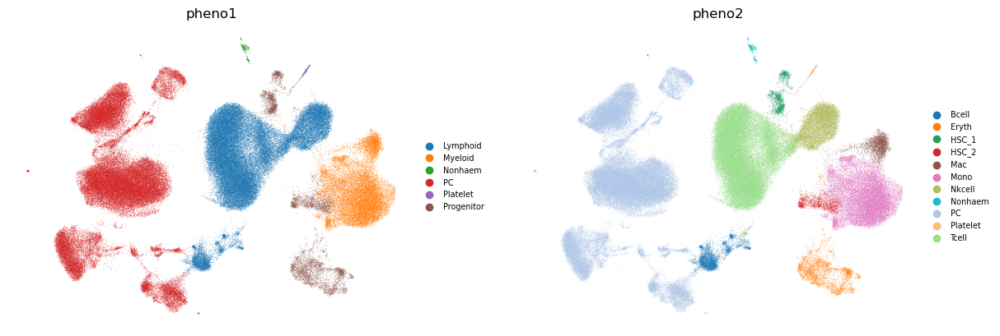

In [163]:
adata_5prime.uns['pheno1_colors'] = ph1_col

sc.pl.embedding(adata_5prime[adata_5prime.obs.pheno1!='QC',], 
    basis="X_umap",frameon=False,ncols=3,color=['pheno1','pheno2'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

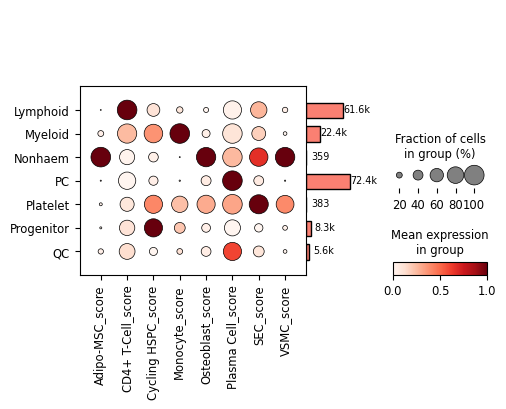

In [184]:
pl = ['Adipo-MSC','CD4+ T-Cell','Cycling HSPC','Monocyte', 'Osteoblast','Plasma Cell','SEC', 'VSMC']
pl = [i+'_score' for i in pl]

dp = sc.pl.dotplot(adata_5prime, pl,'pheno1', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False, return_fig=True)
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

## FLEX samples

### Phenotyping

In [85]:
adata_flex = sc.read('../out/single_cell_object/adata_clean.h5ad')

In [87]:
adata_flex

AnnData object with n_obs × n_vars = 51609 × 18129
    obs: 'og_barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_ig', 'log1p_total_counts_ig', 'pct_counts_ig', 'Scrublet_score', 'Scrublet_doublet', 'SCDS_cxds_score', 'SCDS_bcds_score', 'SCDS_hybrid_score', 'scDblFinder_score', 'scDblFinder_class', 'sample_id', 'thr', 'retrieve_mt', 'leiden'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Scrublet_doublet_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    

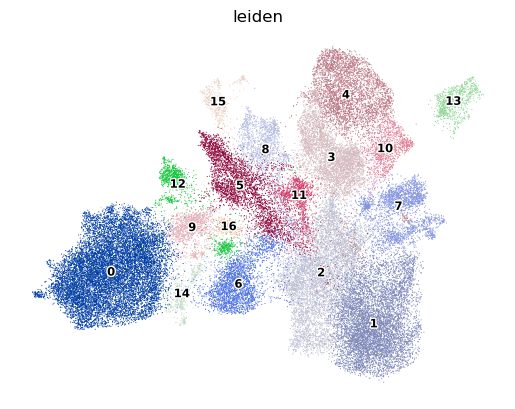

In [89]:
sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,color=["leiden",],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='small')

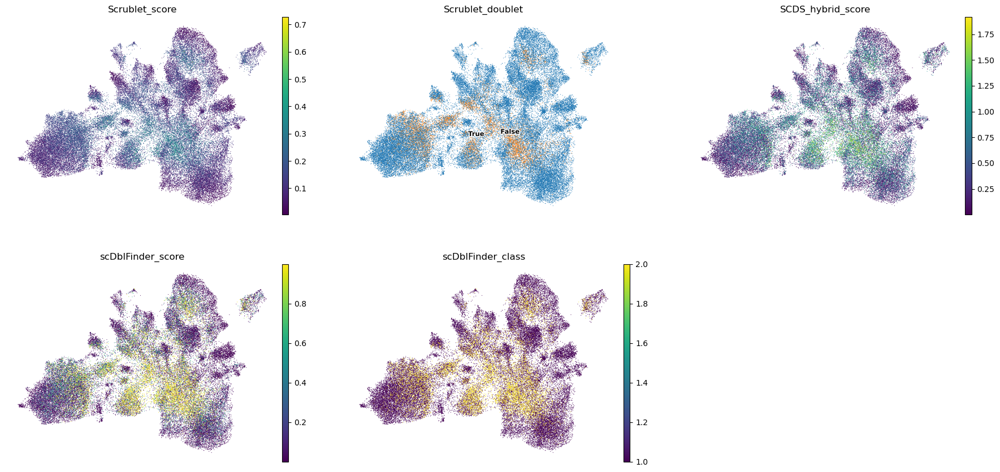

In [102]:
sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,
    color=['Scrublet_score', 'Scrublet_doublet', 'SCDS_hybrid_score', 'scDblFinder_score', 'scDblFinder_class'],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='small')

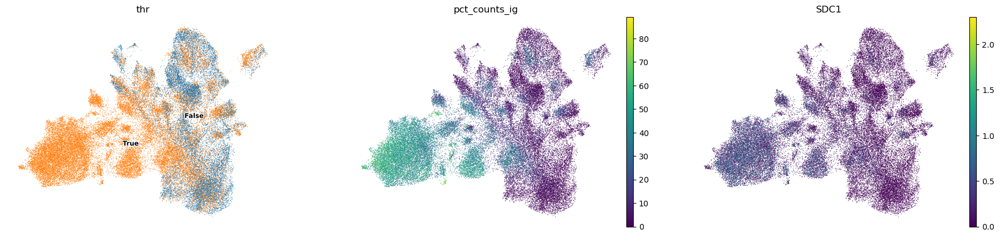

In [98]:
sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,color=["thr",'pct_counts_ig','SDC1'],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='small')

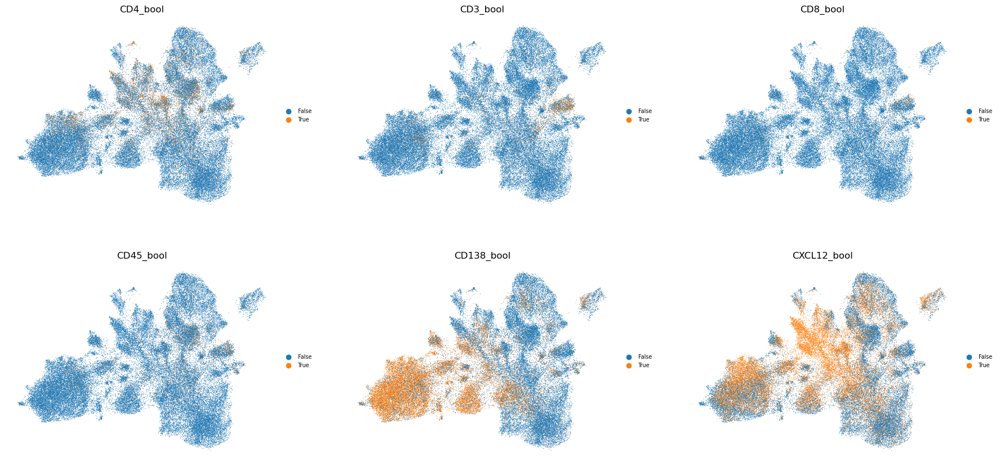

In [101]:
# marker +/-
gene_dicts = {'CD4':['CD4'], 'CD3':['CD3D','CD3E','CD3G'], 'CD8':['CD8A'],'CD45':['PTPRC'],'CD138':['MZB1'],'CXCL12':['CXCL12']}
for key,values in gene_dicts.items():
    X=adata_flex[:,values].X.sum(axis=1)
    adata_flex.obs[key+'_bool'] = np.array(np.array(X, dtype=bool), dtype=str)

sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,color=[i+'_bool' for i in list(gene_dicts.keys())],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

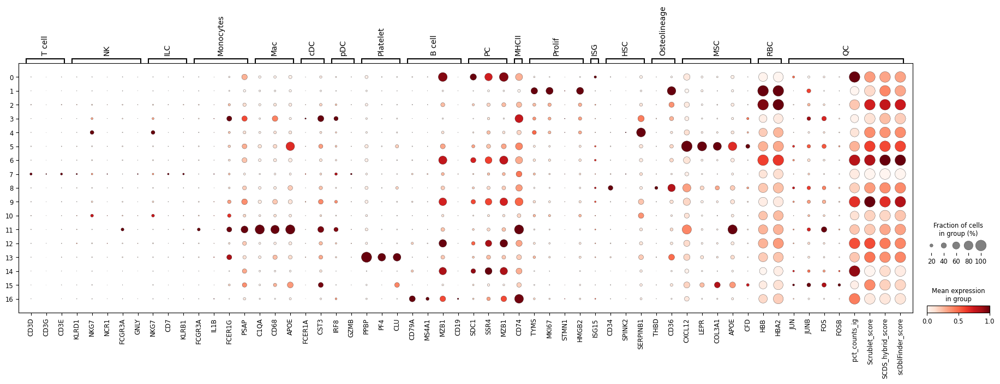

In [90]:
# Marker genes

marker_genes_dict_pl = marker_genes_dict.copy()
for k,v in marker_genes_dict_pl.items():
    marker_genes_dict_pl[k] = [g for g in v if g in  adata_flex.var_names.to_list() + adata_flex.obs.columns.to_list()  ]

sc.pl.dotplot(adata_flex, marker_genes_dict_pl,'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

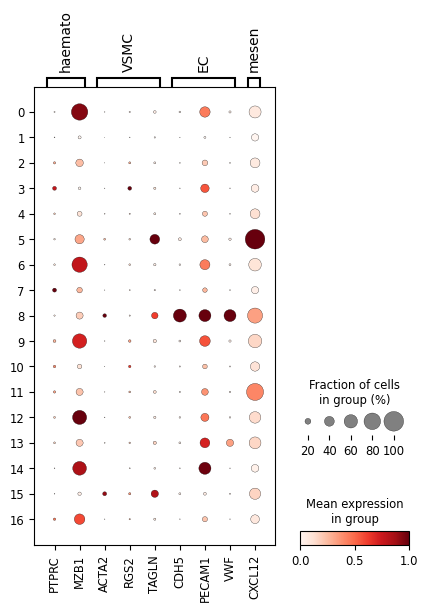

In [91]:
# Bandyo genes

Bandyo_major_pl = Bandyo_major.copy()
for k,v in Bandyo_major_pl.items():
    Bandyo_major_pl[k] = [g for g in v if g in  adata_flex.var_names.to_list() + adata_flex.obs.columns.to_list()  ]

sc.pl.dotplot(adata_flex, Bandyo_major_pl, 'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

In [139]:
# Bandyo signatures
Bandyo_signatures.keys()

dict_keys(['Adipo-MSC', 'AEC', 'APOD+ MSC', 'Ba/Eo/Ma', 'CD4+ T-Cell', 'CD8+ T-Cell', 'CLP', 'Cycling DCs', 'Cycling HSPC', 'Early Myeloid Progenitor', 'Erythroblast', 'Fibro-MSC', 'GMP', 'HSC', 'Late Erythroid', 'Late Myeloid', 'Macrophages', 'Mature B', 'Megakaryocyte', 'MEP', 'Monocyte', 'MPP', 'Neutrophil', 'Osteoblast', 'Osteo-MSC', 'pDC', 'Plasma Cell', 'Pre-B', 'Pre-Pro B', 'Pro-B', 'RBC', 'RNAlo MSC', 'SEC', 'THY1+ MSC', 'VSMC'])

In [92]:
for k,v in Bandyo_signatures.items():
    sc.tl.score_genes(adata_flex,v,score_name=k+'_score')

       'RPS2', 'RPL5', 'RPL31', 'RPL12', 'RPL30', 'RPS12', 'RPS4X',
       'AJ009632.2', 'RPL9', 'RPL11', 'RPL3', 'RPS23', 'RPL32', 'RPL39',
       'SNHG8', 'NACA', 'RPL35A', 'RPL10A', 'RPL15', 'RPS6', 'RPL7A', 'SNHG7',
       'NPM1', 'RPL34'],
      dtype='object')
       'RPLP0', 'RPS2', 'RPL35', 'RPL6', 'RPL7A', 'RPS12', 'RPL36', 'RPS8',
       'HMGB1', 'RPS3A', 'RPS5', 'RPL5', 'RPL27A', 'RPS25', 'RPS23', 'RPL37',
       'RPS16', 'RPL23', 'RPS29', 'AC016831.7', 'HLA-E', 'RPL31', 'RPS28',
       'RPL13A'],
      dtype='object')
       'RPL35', 'RPL23A', 'RPL10', 'RPL41', 'RPS23', 'RPL7A', 'RPL18A',
       'RPS19', 'RPLP0', 'RPL18', 'RPS2', 'NPM1', 'RPL19'],
      dtype='object')
       'LINC00926', 'AP001011.1', 'RPS27', 'RPL21', 'RPL30', 'FAM129C'],
      dtype='object')
       'RPL37A', 'RPLP0', 'RPSA', 'RPS18', 'RPS4X', 'RPL7A', 'RPS6', 'FAM19A2',
       'RPL27A', 'RPL5', 'RPL15', 'RPS24', 'RPS3A', 'RPS3', 'RPL14', 'RPS7'],
      dtype='object')
       'RPS12', 'RPL39', 'RPL7A', '

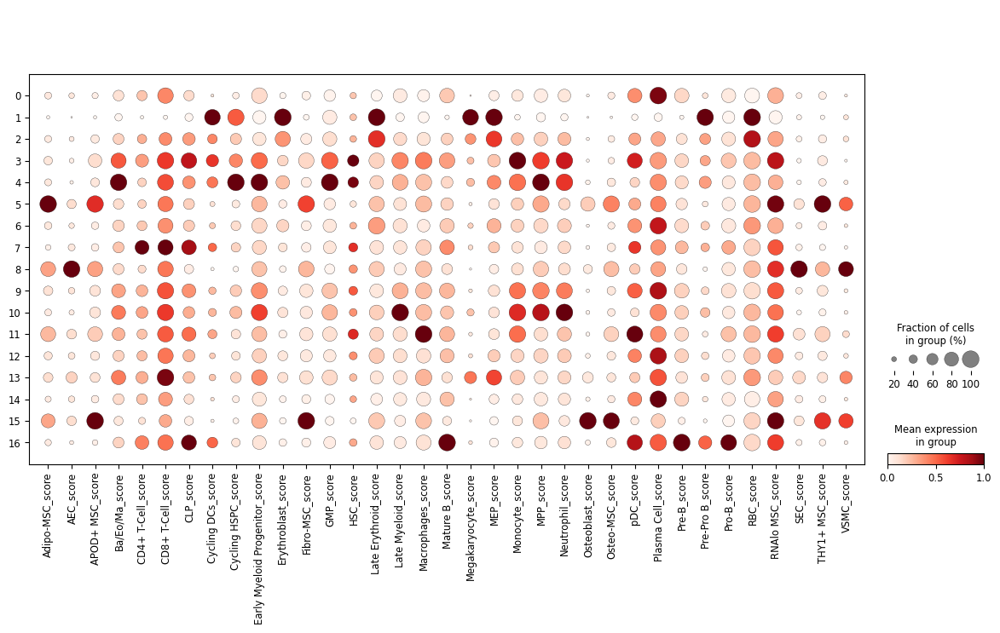

In [94]:
sc.pl.dotplot(adata_flex, [i+'_score' for i in Bandyo_signatures.keys()], 'leiden', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False)

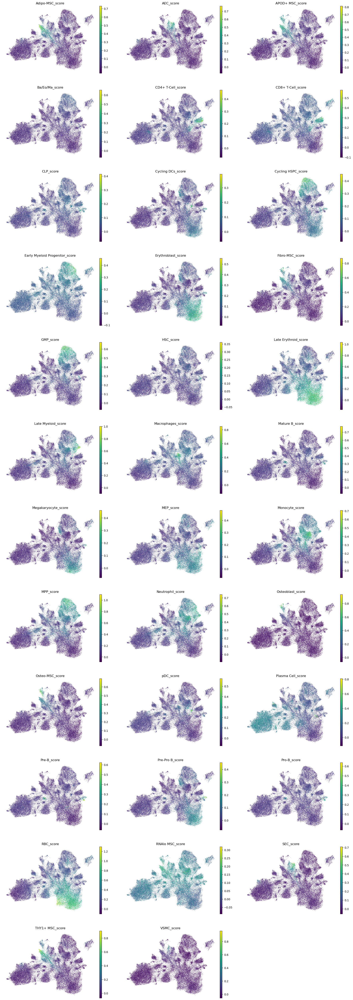

In [103]:
sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,
                color=[i+'_score' for i in Bandyo_signatures.keys()],
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='x-small')

In [108]:
# Marker genes
sc.tl.rank_genes_groups(adata_flex, 'leiden', method='t-test', key_added = "t-test", pts=True);

In [111]:
i='13'
df = sc.get.rank_genes_groups_df(adata_flex, group=i, key='t-test', pval_cutoff=0.01, log2fc_min=0
                                ).sort_values('logfoldchanges',ascending=False)
#df.loc[df.pct_nz_group>0.5,].head(20)

In [112]:
#GNATENKO_PLATELET_SIGNATURE
platelet = [
    'ITM2B', 'UBC', 'B2M', 'TLN1', 'RGS10', 'DYNLL1', 'RNF24', 'FLNA', 
    'TAGLN2', 'OAZ1', 'YWHAH', 'SPARC', 'FTH1P5', 'H2AC18', 'FTH1', 'MLH3', 
    'H3-3A', 'F13A1', 'PTMA', 'CD99', 'TMSB4X', 'CCL5', 'MYL6', 'HBB', 'PF4', 
    'CLU', 'PKM', 'ITGA2B', 'PPBP', 'H2AC6', 'ACTB', 'GNAS', 'TUBA4A', 'GPX1', 
    'MYL12A', 'HLA-E', 'H2AC20', 'HLA-C', 'NCOA4', 'CFL1', 'NRGN', 'PGRMC1', 
    'RPL41', 'H2BC14'
]

sc.tl.score_genes(adata_flex,platelet,score_name='platelet_score')

       'RPL41', 'H2BC14'],
      dtype='object')


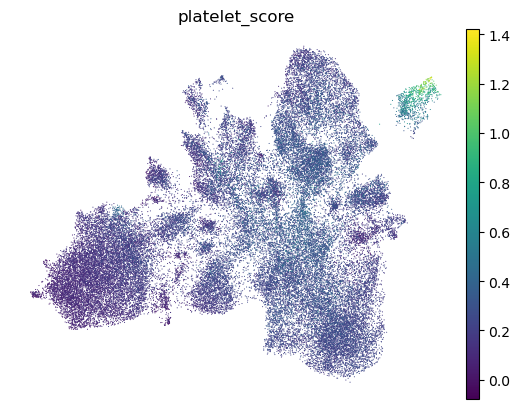

In [113]:
sc.pl.embedding(adata_flex, basis="X_umap",frameon=False,ncols=3,color='platelet_score',
    legend_loc='on data',legend_fontoutline=2,legend_fontsize='x-small')

### Labelling

In [167]:
adata_flex = adata_flex[adata_flex.obs.pheno1!='QC',]

In [140]:
ph = pd.read_csv('../data/phenotypes.csv')
ph=ph[ph.modality=='flex']
ph.leiden=ph.leiden.astype(str)
ph.head(2)

,modality,leiden,pheno1,pheno2
0,flex,0,PC,PC
1,flex,1,Progenitor,Eryth


In [142]:
adata_flex.obs = adata_flex.obs.reset_index().merge(ph, how="left", on='leiden').set_index('index')

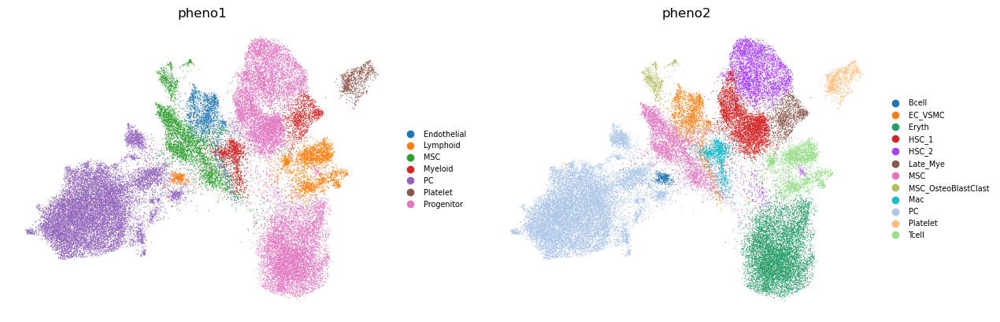

In [168]:
adata_flex.uns['pheno1_colors'] = ph1_col

sc.pl.embedding(adata_flex, 
    basis="X_umap",frameon=False,ncols=3,color=['pheno1','pheno2'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

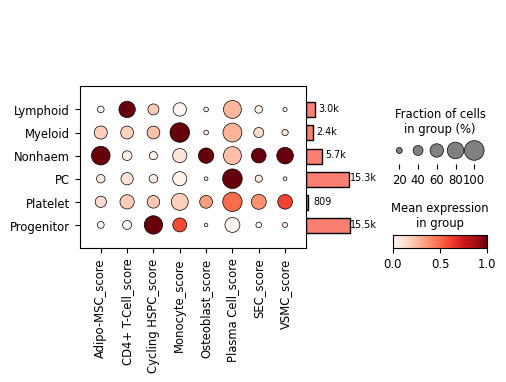

In [185]:
pl = ['Adipo-MSC','CD4+ T-Cell','Cycling HSPC','Monocyte', 'Osteoblast','Plasma Cell','SEC', 'VSMC']
pl = [i+'_score' for i in pl]

adata_flex.obs['pheno1_pl'] = [c if c not in ['MSC','Endothelial'] else 'Nonhaem' for c in adata_flex.obs['pheno1'].to_list()]

dp = sc.pl.dotplot(adata_flex, pl,'pheno1_pl', 
    use_raw=False, swap_axes=False, standard_scale='var', dendrogram=False, return_fig=True)
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

### Sub-clustering

In [191]:
def do_subcluster(adata_clean):
    sc.tl.pca(adata_clean,use_highly_variable=True,random_state=12345)
    import harmonypy as hm
    ho = hm.run_harmony(adata_clean.obsm['X_pca'], adata_clean.obs, ['sample_id'])
    adata_clean.obsm['X_pca_harmony'] = np.transpose(ho.Z_corr)
    sc.pp.neighbors(adata_clean,n_pcs=50,random_state=12345,use_rep='X_pca_harmony')
    sc.tl.umap(adata_clean,random_state=12345)
    sc.tl.leiden(adata_clean,resolution=0.5)
    return adata_clean

#### Non-haem cells

In [190]:
adata_flex_nonhaem = adata_flex[adata_flex.obs.pheno1.isin(['MSC','Endothelial'])]

In [192]:
adata_flex_nonhaem = do_subcluster(adata_flex_nonhaem)

2025-03-28 21:49:24,230 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-28 21:49:28,133 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-28 21:49:28,212 - harmonypy - INFO - Iteration 1 of 10
2025-03-28 21:49:30,761 - harmonypy - INFO - Iteration 2 of 10
2025-03-28 21:49:33,369 - harmonypy - INFO - Iteration 3 of 10
2025-03-28 21:49:35,953 - harmonypy - INFO - Iteration 4 of 10
2025-03-28 21:49:38,238 - harmonypy - INFO - Iteration 5 of 10
2025-03-28 21:49:40,817 - harmonypy - INFO - Iteration 6 of 10
2025-03-28 21:49:42,511 - harmonypy - INFO - Iteration 7 of 10
2025-03-28 21:49:43,600 - harmonypy - INFO - Iteration 8 of 10
2025-03-28 21:49:44,681 - harmonypy - INFO - Iteration 9 of 10
2025-03-28 21:49:45,895 - harmonypy - INFO - Iteration 10 of 10
2025-03-28 21:49:46,874 - harmonypy - INFO - Stopped before convergence


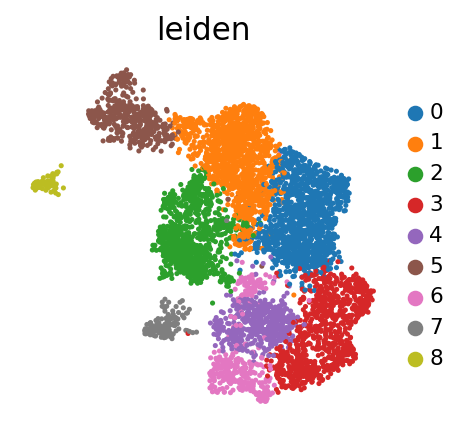

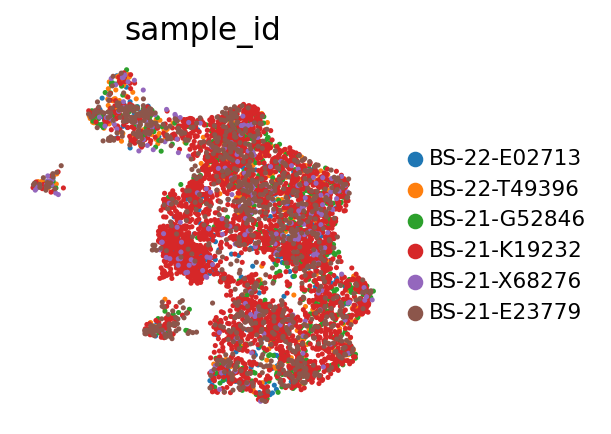

In [250]:
sc.set_figure_params(figsize=(3,3))

sc.pl.embedding(adata_flex_nonhaem, 
    basis="X_umap",frameon=False,ncols=1,color=['leiden'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')
sc.pl.embedding(adata_flex_nonhaem, 
    basis="X_umap",frameon=False,ncols=1,color=['sample_id'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

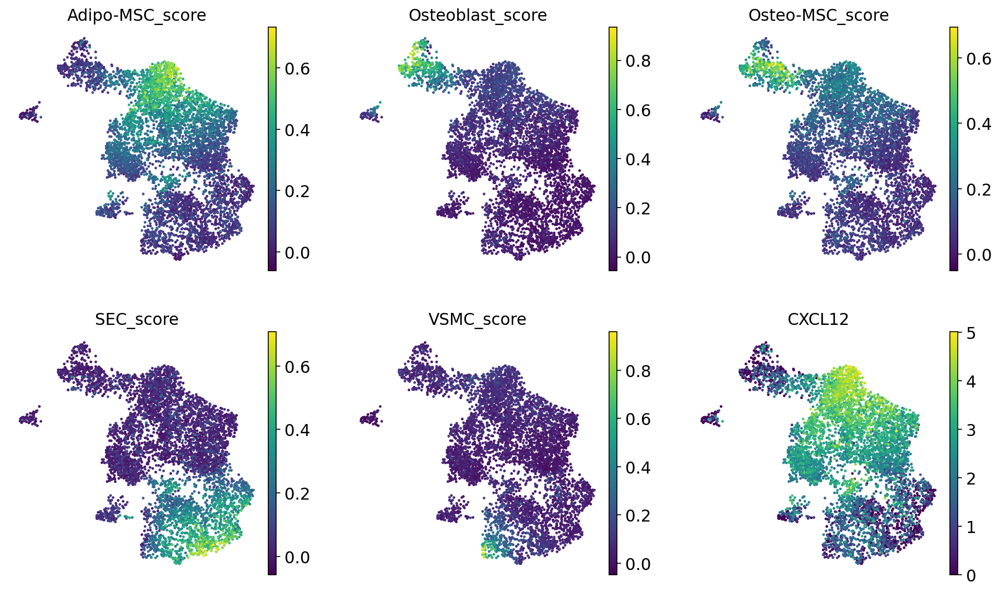

In [246]:
pl = ['Adipo-MSC','Osteoblast','Osteo-MSC','SEC', 'VSMC']
pl = [i+'_score' for i in pl]+['CXCL12']

sc.pl.embedding(adata_flex_nonhaem, 
    basis="X_umap",frameon=False,ncols=3,color=pl,
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')


#### T cells

In [215]:
adata_flex_Tcell = adata_flex[adata_flex.obs.pheno2.isin(['Tcell'])]

In [216]:
adata_flex_Tcell = do_subcluster(adata_flex_Tcell)

2025-03-28 21:57:45,259 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-28 21:57:47,598 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-28 21:57:47,637 - harmonypy - INFO - Iteration 1 of 10
2025-03-28 21:57:48,768 - harmonypy - INFO - Iteration 2 of 10
2025-03-28 21:57:49,939 - harmonypy - INFO - Converged after 2 iterations


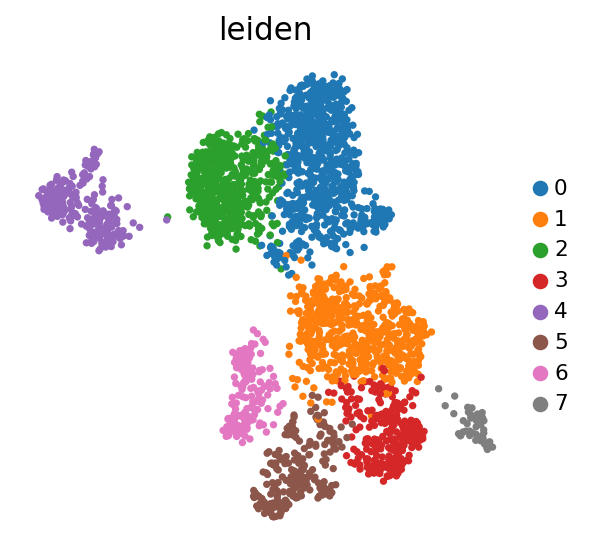

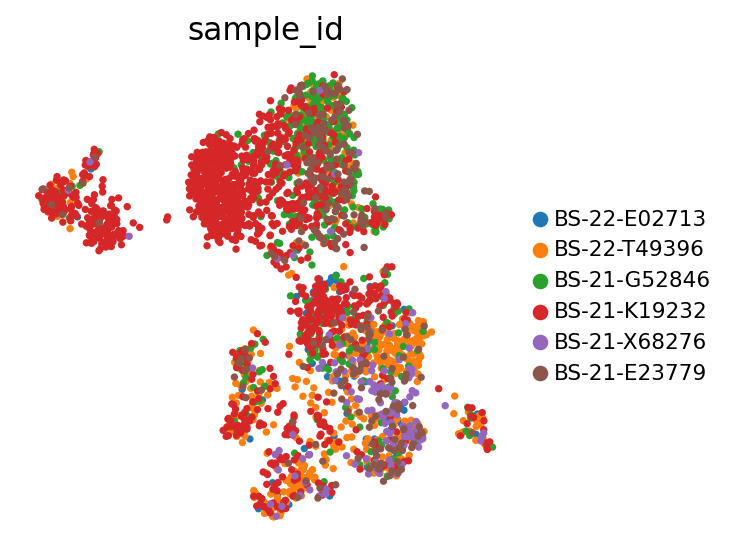

In [248]:
sc.pl.embedding(adata_flex_Tcell, 
    basis="X_umap",frameon=False,ncols=1,color=['leiden'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')
sc.pl.embedding(adata_flex_Tcell, 
    basis="X_umap",frameon=False,ncols=1,color=['sample_id'],
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

In [222]:
cd3 = ['CD3D','CD3E','CD3G']
sc.tl.score_genes(adata_flex_Tcell,cd3,score_name='CD3_score')

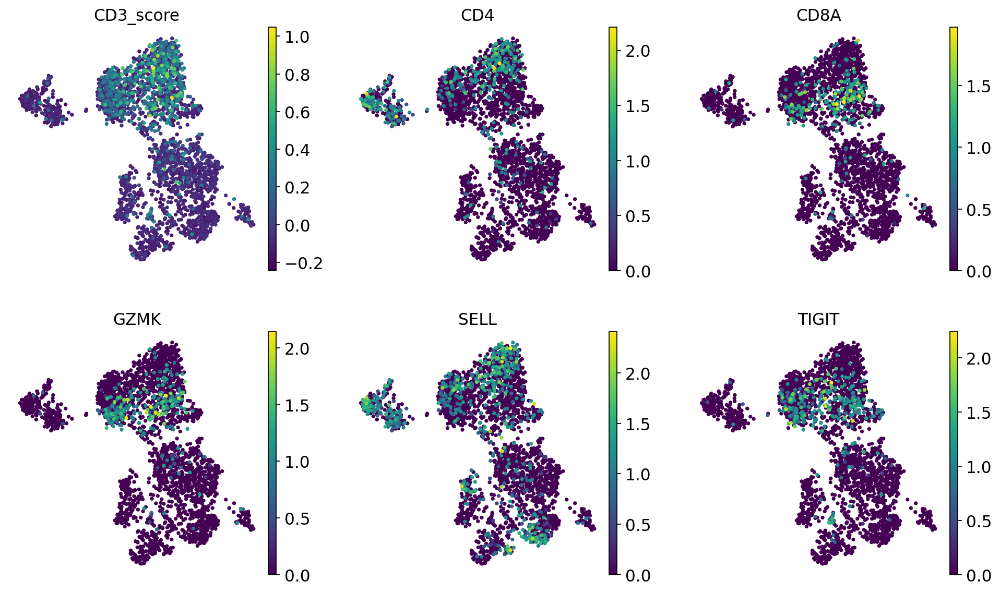

In [247]:
pl = ['CD3_score','CD4','CD8A','GZMK','SELL','TIGIT']

sc.pl.embedding(adata_flex_Tcell, 
    basis="X_umap",frameon=False,ncols=3,color=pl,
    legend_loc='right margin',legend_fontoutline=2,legend_fontsize='x-small')

## Save phenotyped objects

In [ ]:
adata_5prime.write('../out/single_cell_object/adata_5prime_pheno.h5ad',compression='gzip')
adata_flex.write('../out/single_cell_object/adata_flex_pheno.h5ad',compression='gzip')
adata_flex_nonhaem.write('../out/single_cell_object/adata_flex_nonhaem_pheno.h5ad',compression='gzip')
adata_flex_Tcell.write('../out/single_cell_object/adata_flex_Tcell_pheno.h5ad',compression='gzip')

In [255]:
# Save obs
adata_5prime.obs['X_umap1'] = adata_5prime.obsm['X_umap'][:,0]
adata_5prime.obs['X_umap2'] = adata_5prime.obsm['X_umap'][:,1]
adata_flex.obs['X_umap1'] = adata_flex.obsm['X_umap'][:,0]
adata_flex.obs['X_umap2'] = adata_flex.obsm['X_umap'][:,1]

adata_5prime.obs.to_csv('../out/single_cell_object/adata_5prime_pheno.csv',index=False)
adata_flex.obs.to_csv('../out/single_cell_object/adata_flex_pheno.csv',index=False)

In [253]:
sc.read('../out/single_cell_object/adata_5prime_clean.h5ad').obs.to_csv(
    '../out/single_cell_object/adata_5prime_clean.csv',index=False)
sc.read('../out/single_cell_object/adata_clean.h5ad').obs.to_csv(
    '../out/single_cell_object/adata_flex_clean.csv',index=False)

# v1 analysis

In [53]:
adata_mono = sc.read('../out/single_cell_object/Monocytes_clustered.h5ad')
adata_T = sc.read('../out/single_cell_object/T-NK_clustered.h5ad')
adata_B = sc.read('../out/single_cell_object/B_clustered.h5ad')
adata_unclassified = sc.read('../out/single_cell_object/Unclassified_clustered.h5ad')

In [3]:
def plot_gene_counts(adata):
    fig, ax=plt.subplots(figsize=(15,6))
    sc.pl.violin(adata, 'n_genes_by_counts', groupby='leiden',ax=ax, show=False)
    ax.set_xlabel('Leiden cluster')
    ax.set_ylabel('Number of genes per cell')
    plt.show()

def plot_heatmaps(adata,marker_genes, label):
    fig, axes=plt.subplots(1,2,figsize=(15,6))
    sc.pl.matrixplot(
        adata,
        marker_genes,
        groupby=label,
        cmap="bwr",
        dendrogram=True,
        show=False,
        ax=axes[0])
    sc.pl.matrixplot(
        adata,
        marker_genes,
        groupby=label,
        standard_scale='var',
        vmin=-.1,
        vmax=1,
        cmap="bwr",
        colorbar_title='Scaled mean expression',
        dendrogram=True,
        show=False,
        ax=axes[1])
    plt.show()

def update_labels(adata,label_dict):
    adata.obs['minor_cell_type'] = adata.obs["leiden"].map(label_dict)
    return adata


def plot_umap_double(adata, lab1,lab2):
    fig, axes = plt.subplots(1,2,figsize=(15,6))
    sc.pl.umap(adata, color=[lab1],size=4, legend_loc=None,ax=axes[0],show=False)
    sc.pl.umap(adata, color=[lab2],size=4,ax=axes[1],show=False, legend_loc='on data')
    plt.show()

def get_genes(adata, cluster_number,key='cluster_degs'):
    df = sc.get.rank_genes_groups_df(adata, key=key, group=cluster_number)
    df['pvals_adj'] = df['pvals_adj'].astype(float)
    df = df[df['pvals_adj'] < 0.5]
    df = df.loc[~df['names'].str.startswith('ENSG'),]
    df = df.sort_values(by='logfoldchanges',ascending=False)
    return df

In [29]:
B_genes_set=['n_genes_by_counts',
             'total_counts',
             'pct_counts_mt',
             'CD19','MS4A1','IL4R','SELL',
             'ABCB1','FCER2','TCL1A','SOX4',
             'CD38','IGHD','CD27','TNFRSF13B',
             'CD1C','PLD4','IGHM','IGHG1','IGHG2',
             'IGHG3','IGHG4','IGHA1','IGHA2','IGHE',
             'FAS','TBX21','ITGAX','FCRL3','CD99',
             'ITGB1','RASSF6','TCF7','TCF4','SDC1',
             'JUN','FOS','FOSB']




In [ ]:
for f in B_genes_set:
    plot_umap_double(adata_B, f, 'leiden')

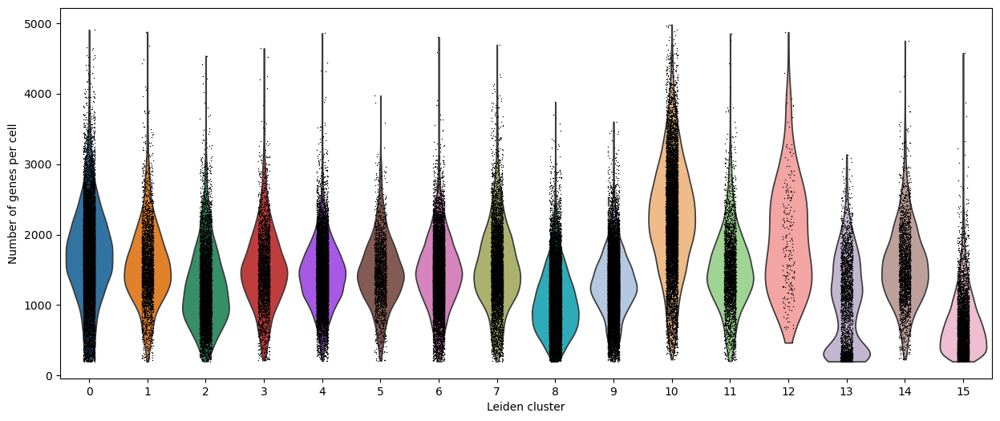

In [33]:
plot_gene_counts(adata_B)

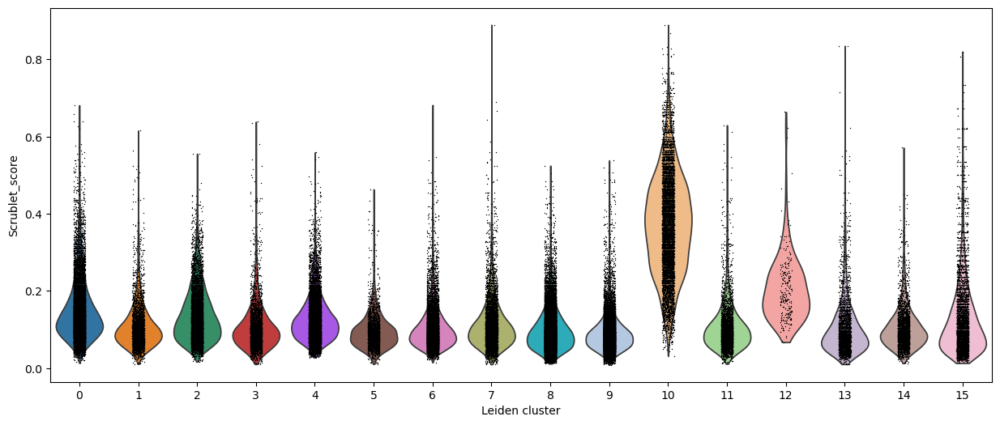

In [34]:
fig, ax=plt.subplots(figsize=(15,6))
sc.pl.violin(adata_B, 'Scrublet_score', groupby='leiden',ax=ax, show=False)
ax.set_xlabel('Leiden cluster')
ax.set_ylabel('Scrublet_score')
plt.show()


In [41]:
get_genes(adata_B, '15').tail(20)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
38596,RPS28,-87.305168,-4.122261,0.000000e+00,0.000000e+00,0.256098,0.871091
38580,CD52,-80.226486,-4.204021,0.000000e+00,0.000000e+00,0.116659,0.788606
38597,RPS21,-87.787025,-4.234888,0.000000e+00,0.000000e+00,0.207547,0.865468
38601,RPS19,-89.999535,-4.263545,0.000000e+00,0.000000e+00,0.257018,0.884999
38603,MT-CO2,-93.966095,-4.282062,0.000000e+00,0.000000e+00,0.289692,0.977147
37627,TMEM160,-13.658044,-4.295753,1.807753e-42,6.923622e-41,0.004142,0.126588
38367,COX8A,-29.184523,-4.308353,3.048376e-187,4.745387e-185,0.009434,0.271872
33074,GZMM,-3.625772,-4.319802,2.880991e-04,1.968907e-03,0.001381,0.033818
31208,CCL4,-2.192954,-4.362074,2.831070e-02,1.442665e-01,0.000920,0.020531
38602,RPL37,-90.450912,-4.397874,0.000000e+00,0.000000e+00,0.235619,0.881182


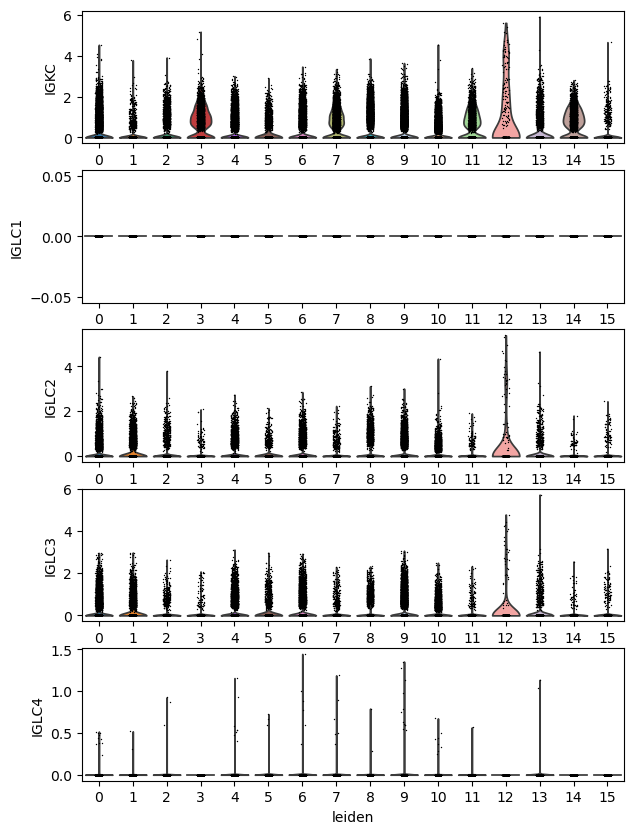

In [44]:
fig, axes = plt.subplots(5,1,figsize=(7,10))
genes_oi = ['IGKC', 'IGLC1', 'IGLC2', 'IGLC3', 'IGLC4']

for i,n in enumerate(genes_oi):
    sc.pl.violin(adata_B,n , groupby='leiden', ax=axes[i],show=False)
plt.show()

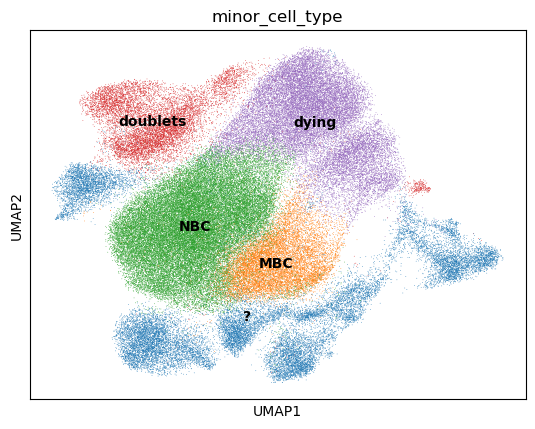

In [43]:
b_dict = {'0': 'MBC',
          '1': '?',
          '2': 'dying',
          '3': '?',
          '4': 'NBC',
          '5': 'NBC',
          '6': 'NBC',
          '7': '?',
          '8': 'dying',
          '9': 'NBC',
          '10': 'doublets',
          '11': '?',
          '12': 'doublets',
          '13': '?',
          '14': 'NBC',
          '15': '?'}

adata_B = update_labels(adata_B, b_dict)
sc.pl.umap(adata_B, color='minor_cell_type', legend_loc='on data')

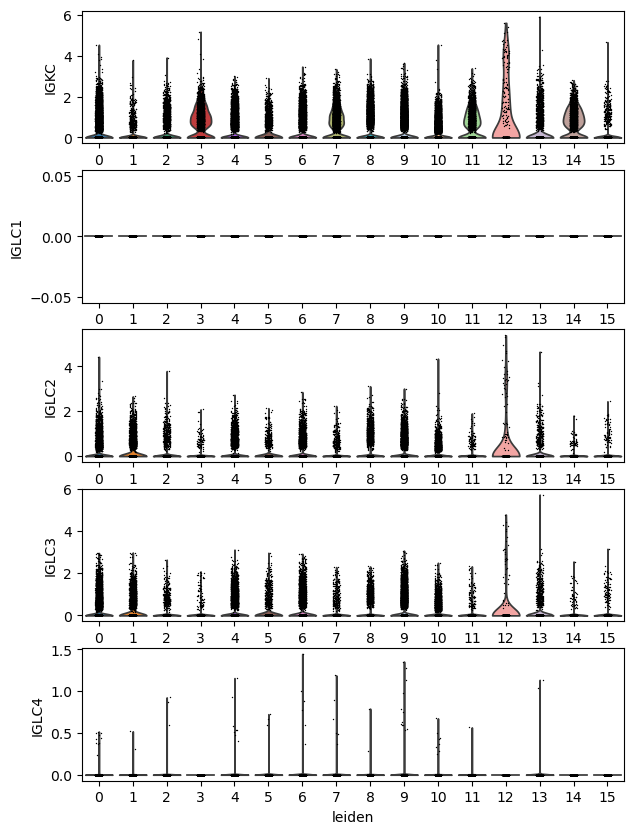

In [54]:
fig, axes = plt.subplots(5,1,figsize=(7,10))
genes_oi = ['IGKC', 'IGLC1', 'IGLC2', 'IGLC3', 'IGLC4']

for i,n in enumerate(genes_oi):
    sc.pl.violin(adata_B,n , groupby='leiden', ax=axes[i],show=False)
plt.show()

In [48]:
b_marker = {
    'NBC': ['MS4A1', 'IL4R', 'SELL', 'IGHD'],
    'MBC': ['CD27', 'TNFRSF13B', 'IGHM', 'IGHG1', 'IGHA1']
}

categories: ?, MBC, NBC, etc.
var_group_labels: NBC, MBC
categories: ?, MBC, NBC, etc.
var_group_labels: NBC, MBC


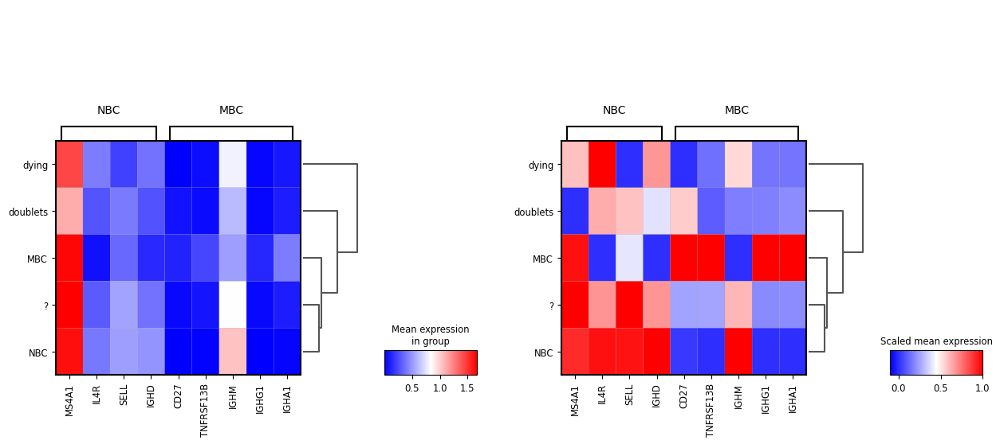

In [49]:
plot_heatmaps(adata_B,b_marker,'minor_cell_type')

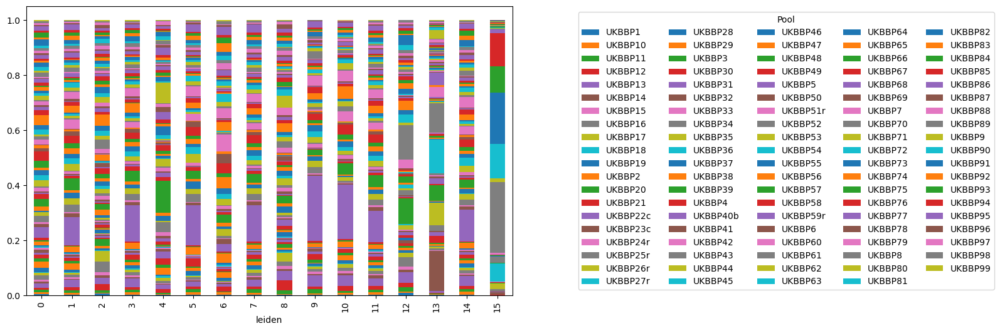

In [50]:
df = pd.DataFrame(adata_B.obs[['Pool_ID','leiden']].groupby(['leiden','Pool_ID']).value_counts()).groupby(level=0).apply(lambda x: x / x.sum()).unstack()
pivot_df = df.reindex(sorted(df.columns), axis=1)
pivot_df=pivot_df.reset_index(level=0, drop=True)
pivot_df.columns=pivot_df.columns.droplevel(level=0)
# # # Plot the stacked bar plot
fig,ax = plt.subplots(1,1,figsize=(10,6))
pivot_df.plot(kind='bar', stacked=True,legend=False,ax=ax)
ax.legend(loc='center right', bbox_to_anchor=(2, .5), title='Pool', ncol=5)
plt.show()


In [51]:
pd.DataFrame(pivot_df.iloc[13,:].sort_values(ascending=False)).head(10)

,13
Pool_ID,
UKBBP14,0.147037
UKBBP36,0.122165
UKBBP43,0.108632
UKBBP26r,0.080102
UKBBP3,0.058522
UKBBP59r,0.044989
UKBBP51r,0.036942
UKBBP9,0.033285
UKBBP21,0.024140


In [52]:
pd.DataFrame(pivot_df.iloc[15,:].sort_values(ascending=False)).head(10)

,15
Pool_ID,
UKBBP52,0.257708
UKBBP55,0.185918
UKBBP54,0.124482
UKBBP58,0.120571
UKBBP57,0.093649
UKBBP36,0.066038
UKBBP43,0.022780
UKBBP26r,0.020018
UKBBP59r,0.013806


In [55]:
adata_unclassified

AnnData object with n_obs × n_vars = 87675 × 38606
    obs: 'og_barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Sample_ID', 'Thaw_by', 'Count_by', 'Re-Thaw', 'Clog', 'Manual_count', 'Sample_quality', 'Data_cDNA', 'cDNA_by', 'quality', 'Date_GEX', 'GEX_by', 'Date_TCRamp', 'TCRamp_by', 'Date_TCR', 'TCR_by', 'Scrublet_score', 'Scrublet_doublet', 'SCDS_cxds_score', 'SCDS_bcds_score', 'SCDS_hybrid_score', 'scDblFinder_score', 'scDblFinder_class', 'Pool_ID', 'retrieve_mt', 'leiden', 'major_cell_type'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns

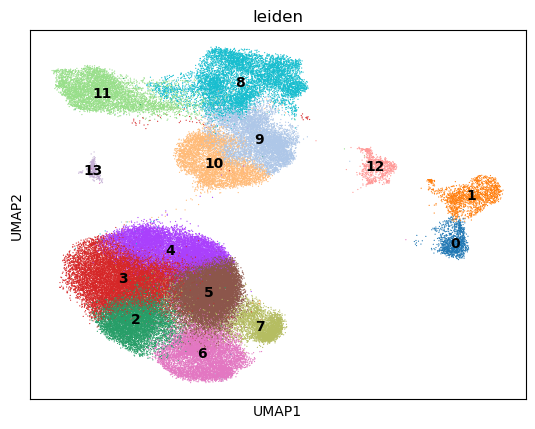

In [56]:
sc.pl.umap(adata_unclassified,color='leiden',size=3,legend_loc='on data')

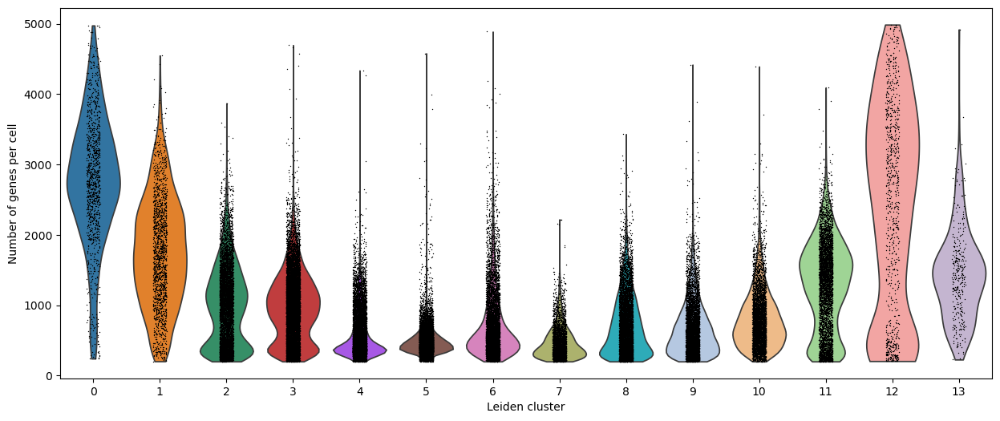

In [57]:
plot_gene_counts(adata_unclassified)

In [ ]:
genes_oi = ['n_genes_by_counts',
             'total_counts',
             'pct_counts_mt','IL3RA', 'GZMB', 'IGLL5','LYZ', 'CD3D', 'MS4A1', 'NKG7', 'PPBP', 'CD34']

for f in genes_oi:
    plot_umap_double(adata_unclassified, f, 'leiden')


In [62]:
get_genes(adata_unclassified,'0').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
6031,SMIM6,5.666090,8.584132,1.460929e-08,9.199255e-08,0.098832,0.000139
19,LILRA4,48.666969,7.973222,0.000000e+00,0.000000e+00,0.851752,0.005707
7826,TMEM210,3.345483,7.882130,8.213932e-04,3.967310e-03,0.058401,0.000127
1107,IGHJ2P,21.130402,7.648553,4.179800e-99,1.452434e-97,0.369272,0.001097
3019,PPP1R14B-AS1,11.935345,7.631878,7.743713e-33,9.792132e-32,0.208446,0.000520
141,LRRC26,37.924446,7.609717,0.000000e+00,0.000000e+00,0.663971,0.003385
8984,HMHB1,2.261005,7.540051,2.375897e-02,9.963490e-02,0.039533,0.000150
2027,KRT5,15.498615,7.519897,3.544516e-54,6.681620e-53,0.271339,0.001329
106,PTCRA,39.840988,7.353794,0.000000e+00,0.000000e+00,0.698113,0.004147
86,SCT,40.989796,7.324108,0.000000e+00,0.000000e+00,0.718778,0.004413


In [63]:
get_genes(adata_unclassified,'12').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
7708,IGLV2-28,2.508488,23.624805,1.212492e-02,5.849722e-02,0.050420,0.000000
8353,CERNA2,2.030680,22.119621,4.228742e-02,1.876061e-01,0.040816,0.000000
9110,LINC01484,1.552873,20.862562,1.204534e-01,4.887256e-01,0.031212,0.000000
8634,IGLV1-41,1.850942,15.001206,6.417796e-02,2.753561e-01,0.037215,0.000012
6437,IGKV3OR2-268,3.640304,10.637012,2.723159e-04,1.583764e-03,0.073229,0.000058
2813,MIXL1,8.715381,9.619159,2.897840e-18,3.883166e-17,0.175270,0.000081
4107,SPACA3,6.325519,9.618649,2.523824e-10,2.308334e-09,0.127251,0.000104
1140,IGF1,14.803193,9.583613,1.396899e-49,4.657055e-48,0.297719,0.000150
7786,IGKV3D-15,2.442411,9.273481,1.458953e-02,6.960495e-02,0.049220,0.000127
3557,IGHJ4,7.220212,9.208824,5.190671e-13,5.497697e-12,0.145258,0.000127


We can't identify further cell types

In [64]:
adata_T

AnnData object with n_obs × n_vars = 400897 × 38606
    obs: 'og_barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Sample_ID', 'Thaw_by', 'Count_by', 'Re-Thaw', 'Clog', 'Manual_count', 'Sample_quality', 'Data_cDNA', 'cDNA_by', 'quality', 'Date_GEX', 'GEX_by', 'Date_TCRamp', 'TCRamp_by', 'Date_TCR', 'TCR_by', 'Scrublet_score', 'Scrublet_doublet', 'SCDS_cxds_score', 'SCDS_bcds_score', 'SCDS_hybrid_score', 'scDblFinder_score', 'scDblFinder_class', 'Pool_ID', 'retrieve_mt', 'leiden', 'major_cell_type'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    un

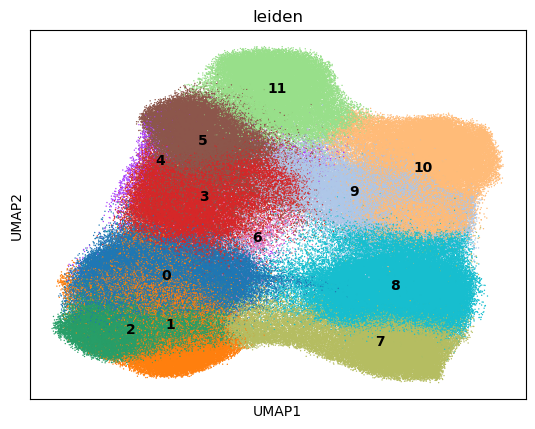

In [65]:
sc.pl.umap(
    adata_T,
    color='leiden',
    size=4,
    ncols=1, legend_loc='on data')

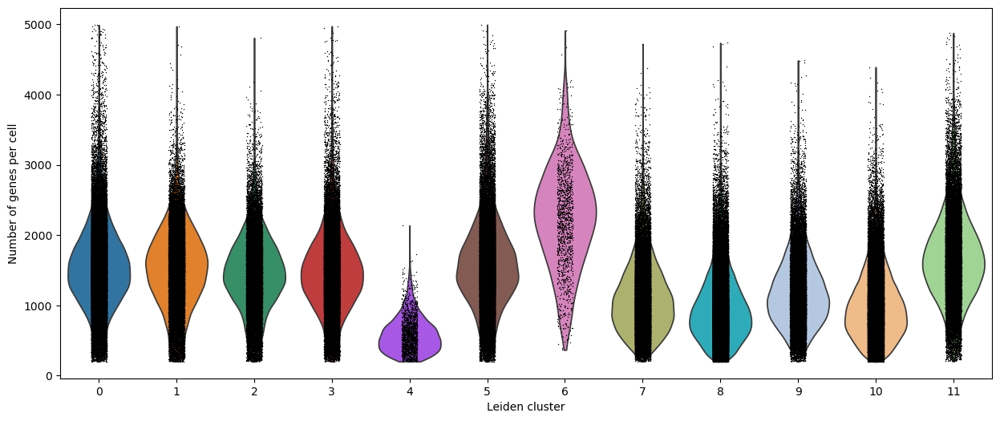

In [66]:
plot_gene_counts(adata_T)

In [74]:
genes_oi = ['CD3D', 'CD4', 'CD8B', 'NELL2', 'LINC02446', 
            'CCR7', 'SELL', 'IL7R', 'HNRNPLL', 'CCR4', 
            'CCR6', 'CXCR3', 'KLRB1', 'GZMK', 'GZMB', 
            'FCGR3A', 'KLRC2', 'KIR2DL1', 'KIR2DL3', 
            'SLC4A7', 'TRGV9', 'TRDV2', 'HLA-DRA', 
            'HLA-DRB1', 'CD38', 'ISG15', 'MX1', 
            'IFI44L', 'IFIT1', 'IFIT2', 'IFIT3',
            'JUN', 'FOS', 'FOSB', 'DUSP1', 
            'CCL3', 'CCL4','PTPRC','NCAM1','ITGAM', 'MS4A1']

In [75]:
adata_T

AnnData object with n_obs × n_vars = 400897 × 38606
    obs: 'og_barcodes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Sample_ID', 'Thaw_by', 'Count_by', 'Re-Thaw', 'Clog', 'Manual_count', 'Sample_quality', 'Data_cDNA', 'cDNA_by', 'quality', 'Date_GEX', 'GEX_by', 'Date_TCRamp', 'TCRamp_by', 'Date_TCR', 'TCR_by', 'Scrublet_score', 'Scrublet_doublet', 'SCDS_cxds_score', 'SCDS_bcds_score', 'SCDS_hybrid_score', 'scDblFinder_score', 'scDblFinder_class', 'Pool_ID', 'retrieve_mt', 'leiden', 'major_cell_type'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    un

In [ ]:
for f in ['n_genes_by_counts','total_counts','pct_counts_mt'] + genes_oi:
    plot_umap_double(adata_T, f, 'leiden')


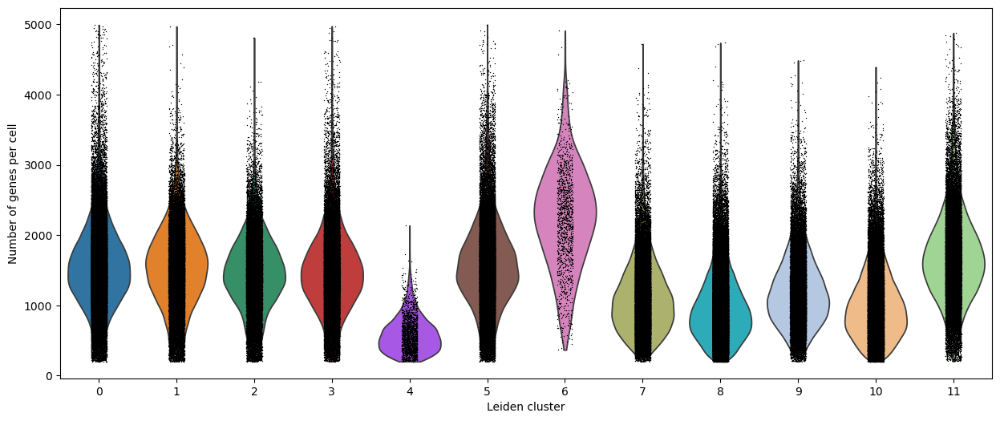

In [77]:
plot_gene_counts(adata_T)

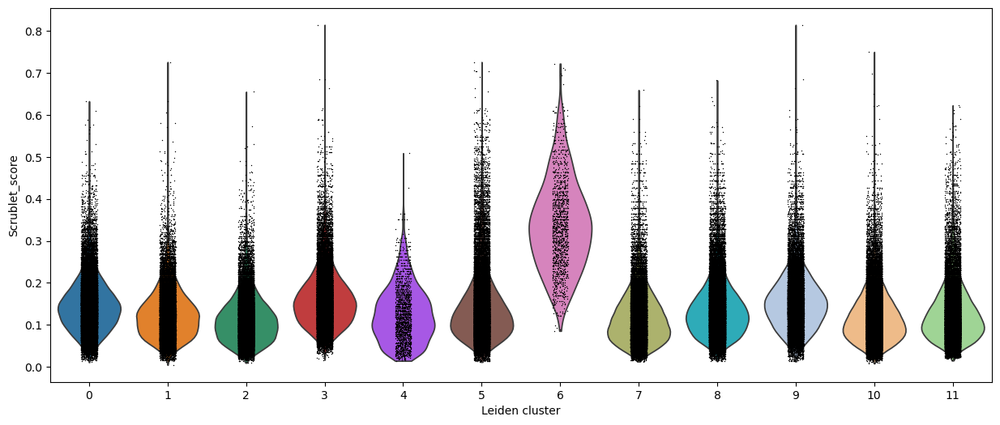

In [78]:
fig, ax=plt.subplots(figsize=(15,6))
sc.pl.violin(adata_T, 'Scrublet_score', groupby='leiden',ax=ax, show=False)
ax.set_xlabel('Leiden cluster')
ax.set_ylabel('Scrublet_score')
plt.show()


In [80]:
get_genes(adata_T,'0').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
2926,AIRE,8.086671,3.747292,6.131786e-16,5.438174e-15,0.024076,0.001703
3406,GATA3-AS1,6.325606,3.368849,2.522402e-10,1.919193e-09,0.019108,0.001603
3036,IL2,7.641580,3.278344,2.145722e-14,1.832693e-13,0.023171,0.002022
5435,PTGDR2,2.376343,3.272923,1.748522e-02,8.248220e-02,0.007241,0.000666
5220,ZP1,2.647366,3.266393,8.112158e-03,3.993089e-02,0.008025,0.000700
5966,LINC02195,1.821664,3.231627,6.850605e-02,2.932414e-01,0.005632,0.000592
2355,KRT1,11.014279,3.128722,3.261351e-28,3.604572e-27,0.034334,0.003858
1408,NEFL,19.609821,2.991290,1.274806e-85,2.391406e-84,0.061750,0.007480
3753,CCR8,5.378855,2.925537,7.496123e-08,5.168696e-07,0.016574,0.001686
796,TTC39C-AS1,32.923779,2.845271,1.004111e-237,3.527272e-236,0.105195,0.014021


In [81]:
get_genes(adata_T,'1').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
5700,REG4,1.805127,2.894547,7.105481e-02,2.995678e-01,0.007245,0.000998
17,LTB,202.109375,2.610483,0.000000e+00,0.000000e+00,0.946761,0.355798
1,RPS12,215.564087,2.594481,0.000000e+00,0.000000e+00,0.999269,0.682759
2,RPS13,212.746719,2.479020,0.000000e+00,0.000000e+00,0.992157,0.591455
19,RPLP1,201.754623,2.410193,0.000000e+00,0.000000e+00,0.998471,0.690784
0,RPL32,215.988174,2.388034,0.000000e+00,0.000000e+00,0.996378,0.690601
18,RPL10,201.760757,2.361706,0.000000e+00,0.000000e+00,0.996976,0.705253
7,RPL30,207.758102,2.355851,0.000000e+00,0.000000e+00,0.994915,0.670725
1896,NOG,11.175169,2.349957,5.394783e-29,6.286477e-28,0.047124,0.008401
26,RPL39,198.364822,2.324329,0.000000e+00,0.000000e+00,0.993154,0.633035


In [82]:
get_genes(adata_T,'2').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
4547,REG4,2.600301,3.638582,9.314212e-03,4.359384e-02,0.009864,0.000797
863,NOG,20.055931,3.601178,1.791568e-89,3.775397e-88,0.076071,0.006143
5568,SFRP5,1.630107,3.298552,1.030789e-01,4.028207e-01,0.006317,0.000633
277,AIF1,55.903282,3.253016,0.000000e+00,0.000000e+00,0.219700,0.025212
1608,LINC02295,11.438286,3.134667,2.691502e-30,3.158301e-29,0.044555,0.004667
1320,CELA1,13.423125,2.969993,4.426443e-41,6.079233e-40,0.053574,0.006782
4478,GP5,2.693892,2.910161,7.062308e-03,3.355661e-02,0.010607,0.001212
3954,DBNDD1,3.413412,2.906156,6.415487e-04,3.394686e-03,0.013647,0.001745
3856,CD248,3.578092,2.905620,3.461122e-04,1.871429e-03,0.014255,0.001778
2577,PADI4,6.545787,2.847736,5.918278e-11,4.533354e-10,0.026314,0.003485


In [83]:
get_genes(adata_T,'4').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
150,IGLV2-14,2.017839,2.312557,4.360807e-02,2.462026e-01,0.046935,0.020319
0,CCL5,39.967144,2.237470,0.000000e+00,0.000000e+00,0.854776,0.432072
1,NKG7,35.238651,2.201970,5.119658e-272,1.162644e-268,0.783545,0.366563
2,GNLY,30.089582,1.996045,6.631908e-199,5.954220e-196,0.763114,0.391577
19,GZMH,16.443956,1.745902,9.266578e-61,9.591032e-59,0.385422,0.204843
85,GZMK,6.295905,1.579118,3.056110e-10,4.879413e-09,0.170072,0.093531
3,IL32,29.529613,1.513011,1.200094e-191,9.084473e-189,0.731640,0.533324
22,GZMA,14.739203,1.410240,3.610179e-49,2.861900e-47,0.403644,0.254208
86,CD8B,6.284725,1.402362,3.284349e-10,5.235161e-09,0.200442,0.132177
5,S100A4,25.517326,1.391596,1.266207e-143,4.888317e-141,0.696853,0.519114


In [84]:
get_genes(adata_T,'5').head(15)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
5001,CFAP58-DT,3.093927,3.825832,1.975263e-03,1.050083e-02,0.010324,0.000711
2,GNLY,248.045288,3.704489,0.000000e+00,0.000000e+00,0.993502,0.330102
256,ZNF683,77.790375,3.611629,0.000000e+00,0.000000e+00,0.267661,0.026794
4165,TRDV3,4.466774,3.561483,7.940802e-06,5.052119e-05,0.015355,0.001480
4,GZMH,223.440399,3.524851,0.000000e+00,0.000000e+00,0.799969,0.143130
1,NKG7,250.933426,3.485443,0.000000e+00,0.000000e+00,0.978854,0.304224
1346,TRDV2,20.396990,3.476784,1.778331e-92,3.689104e-91,0.071691,0.008508
1568,TRDV1,17.315577,3.411639,3.589072e-67,6.272509e-66,0.061000,0.007317
6031,LINC01918,1.869103,3.302394,6.160852e-02,2.691173e-01,0.006367,0.000560
0,CCL5,252.823959,3.189939,0.000000e+00,0.000000e+00,0.981029,0.376426


[<Axes: xlabel='leiden', ylabel='IFIT1'>,
 <Axes: xlabel='leiden', ylabel='IFIT2'>,
 <Axes: xlabel='leiden', ylabel='IFIT3'>]

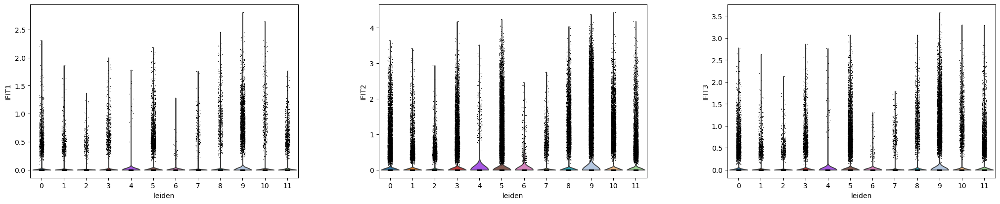

In [87]:
sc.pl.violin(adata_T, ['IFIT1','IFIT2','IFIT3'], groupby='leiden', show=False)


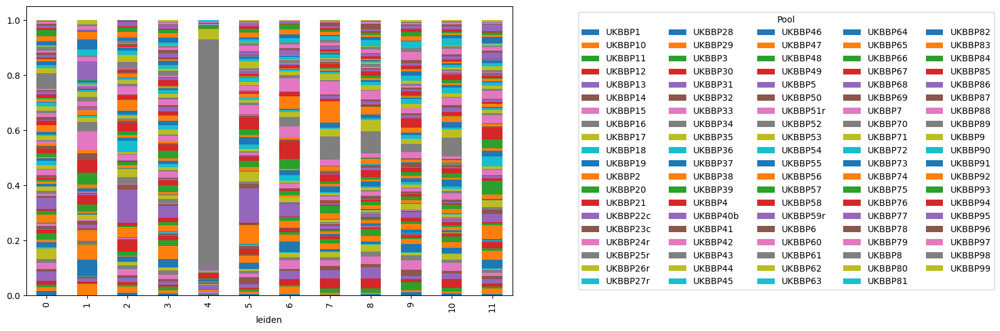

In [88]:
df = pd.DataFrame(adata_T.obs[['Pool_ID','leiden']].groupby(['leiden','Pool_ID']).value_counts()).groupby(level=0).apply(lambda x: x / x.sum()).unstack()
pivot_df = df.reindex(sorted(df.columns), axis=1)
pivot_df=pivot_df.reset_index(level=0, drop=True)
pivot_df.columns=pivot_df.columns.droplevel(level=0)
# # # Plot the stacked bar plot
fig,ax = plt.subplots(1,1,figsize=(10,6))
pivot_df.plot(kind='bar', stacked=True,legend=False,ax=ax)
ax.legend(loc='center right', bbox_to_anchor=(2, .5), title='Pool', ncol=5)
plt.show()

In [89]:
pd.DataFrame(pivot_df.iloc[4,:].sort_values(ascending=False)).head(10)

,4
Pool_ID,
UKBBP61,0.838763
UKBBP62,0.036444
UKBBP49,0.019879
UKBBP31,0.014909
UKBBP66,0.013252
UKBBP90,0.006626
UKBBP46,0.006074
UKBBP2,0.006074
UKBBP15,0.004417


In [91]:
t_dict = {
    '0': 'CD4+ TN/TCM',
    '1': 'CD4+ TN/TCM',
    '2': 'CD4+ TN/TCM',
    '3': 'GZMK+ CD8+ TEM',
    '4': 'GZMK+ CD8+ TEM',
    '5': 'GZMB+ CD8+ TEM',
    '6': 'doublets',
    '7': 'trash',
    '8': 'trash',
    '9': 'IFN+ T',
    '10': 'trash',
    '11': 'NK'
}


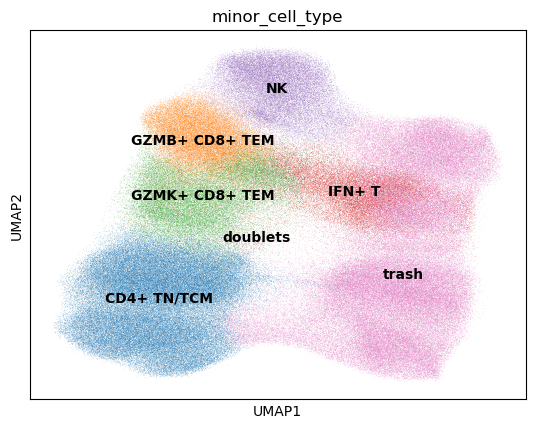

In [92]:
adata_T = update_labels(adata_T, t_dict)
sc.pl.umap(adata_T, color='minor_cell_type', legend_loc='on data')

In [93]:
t_marker = {
    'CD4+ TN/TCM': ['CD3D', 'CD4', 'CCR7', 'IL7R'],
    'GZMK+ CD8+ TEM': ['CD8B', 'GZMK'],
    'GZMB+ CD8+ TEM': ['GZMB', 'FCGR3A', 'PRF1', 'GNLY'],
    'IFN+ T': ['IFIT1', 'IFIT2', 'IFIT3', 'MX1', 'ISG15', 'IFI44L'],
    'NK': ['NKG7']
}

categories: CD4+ TN/TCM, GZMB+ CD8+ TEM, GZMK+ CD8+ TEM, etc.
var_group_labels: CD4+ TN/TCM, GZMK+ CD8+ TEM, GZMB+ CD8+ TEM, etc.
categories: CD4+ TN/TCM, GZMB+ CD8+ TEM, GZMK+ CD8+ TEM, etc.
var_group_labels: CD4+ TN/TCM, GZMK+ CD8+ TEM, GZMB+ CD8+ TEM, etc.


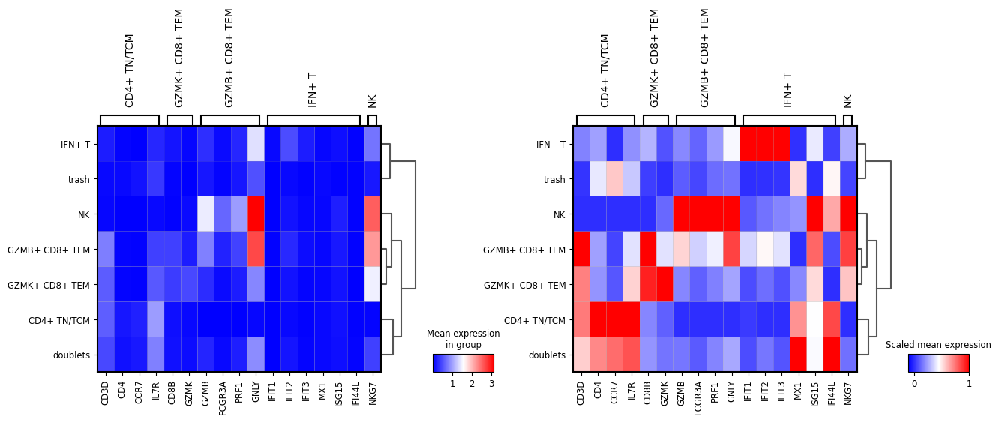

In [94]:
plot_heatmaps(adata_T,t_marker,'minor_cell_type')

## Plots

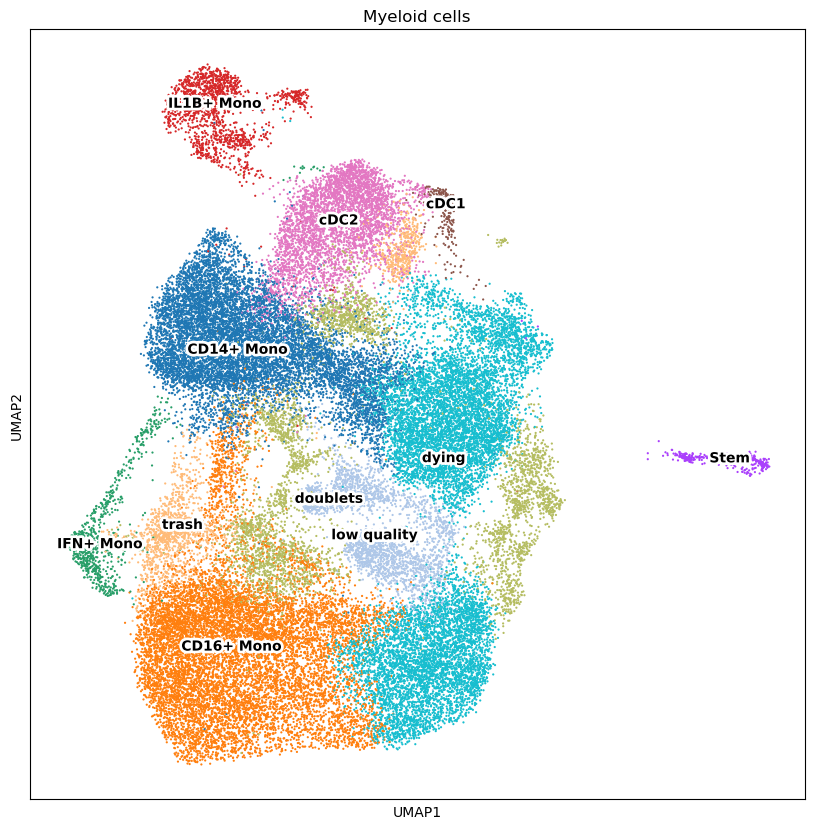

In [97]:
mono_dict = {'0':'CD16+ Mono',
            '1':'dying',
            '2':'CD16+ Mono',
            '3':'doublets',
            '4':'CD14+ Mono',
            '5':'CD14+ Mono',
            '6':'CD14+ Mono',
            '7':'doublets',
            '8': 'low quality',
            '9':'cDC2',
            '10':'trash',
            '11':'doublets',
            '12':'dying',
            '13':'IFN+ Mono',
            '14':'dying',
            '15':'cDC1',
            '16':'Stem',
            '17':'IL1B+ Mono',
            '18':'low quality'}

adata_mono = update_labels(adata_mono,mono_dict)

fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_mono, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='Myeloid cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/myeloid_clusters_dirty.svg', format='svg')
fig.savefig('../figures/myeloid_clusters_dirty.png', format='png', dpi=600)

plt.show()

In [98]:
adata_mono_clean = adata_mono.copy()
adata_mono_clean=adata_mono_clean[-adata_mono_clean.obs['minor_cell_type'].isin(['low quality','trash','dying','doublets'])]

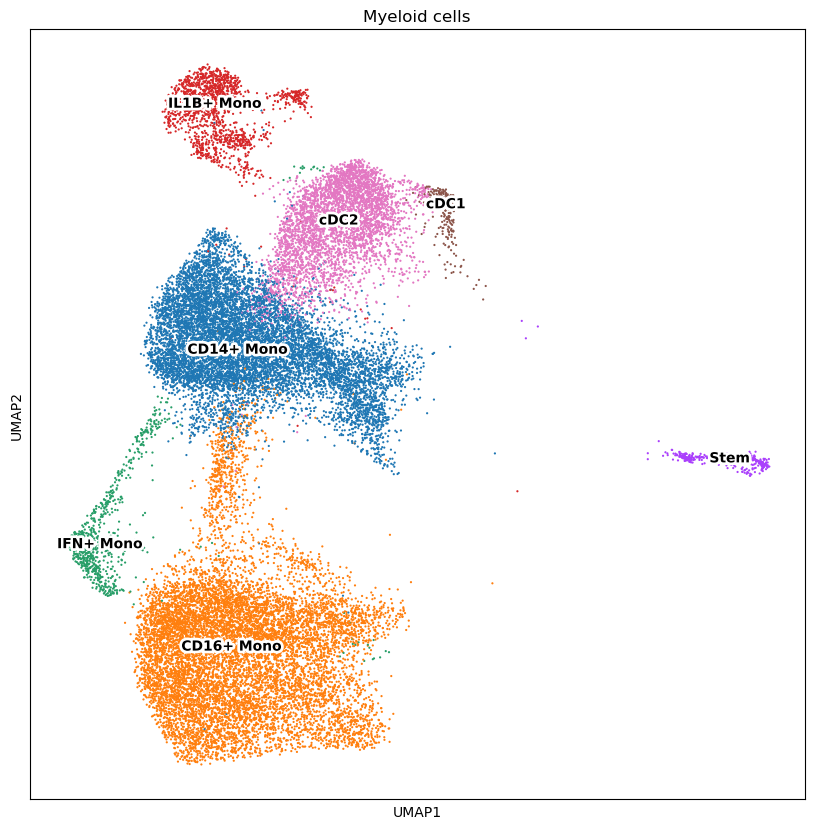

In [99]:
fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_mono_clean, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='Myeloid cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/myeloid_clusters_clean.svg', format='svg')
fig.savefig('../figures/myeloid_clusters_clean.png', format='png', dpi=600)

plt.show()

In [100]:
mono_marker = {
                'CD14+ Mono': ['LYZ', 'CD14'],
                'CD16+ Mono': ['FCGR3A', 'MS4A7'],
                'IL1B+ Mono': ['IL1B', 'CXCL8', 'CCL3', 'CCL4'],
                'IFN+ Mono': ['MX1', 'ISG15', 'IFI44L', 'IFIT1'],
                'cDC2': ['FCER1A', 'CD1C', 'CLEC10A'],
                'cDC1': ['CLEC9A', 'IDO1', 'XCR1'],
                'Stem': ['CD34']
}

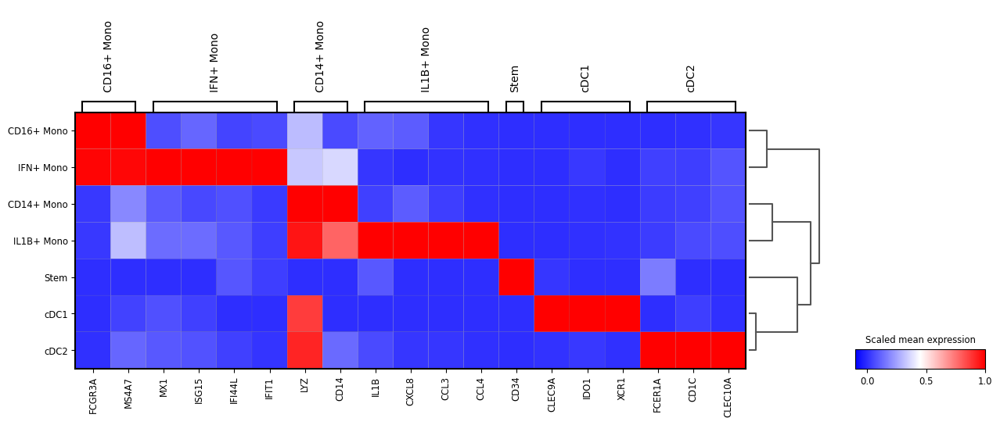

In [101]:
sc.tl.dendrogram(adata_mono_clean, groupby='minor_cell_type')

fig, ax=plt.subplots(1,1,figsize=(15,6))

sc.pl.matrixplot(
    adata_mono_clean,
    mono_marker,
    groupby='minor_cell_type',
    standard_scale='var',
    vmin=-.1,
    vmax=1,
    cmap="bwr",
    colorbar_title='Scaled mean expression',
    dendrogram=True,
    show=False,
    ax=ax)

fig.savefig('../figures/myeloid_heatmap_clean.svg', format='svg')
fig.savefig('../figures/myeloid_heatmap_clean.png', format='png', dpi=600)
plt.show()

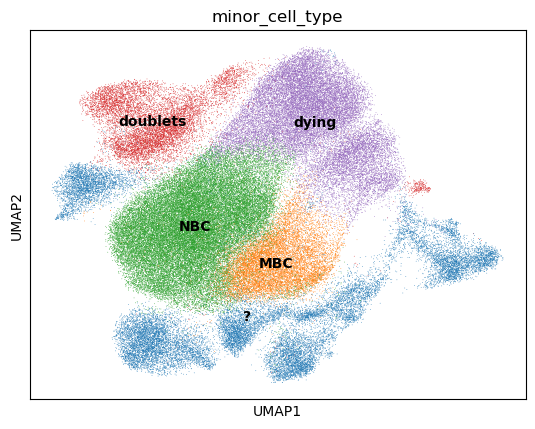

In [102]:
adata_B = update_labels(adata_B,b_dict)
sc.pl.umap(adata_B, color='minor_cell_type', legend_loc='on data')

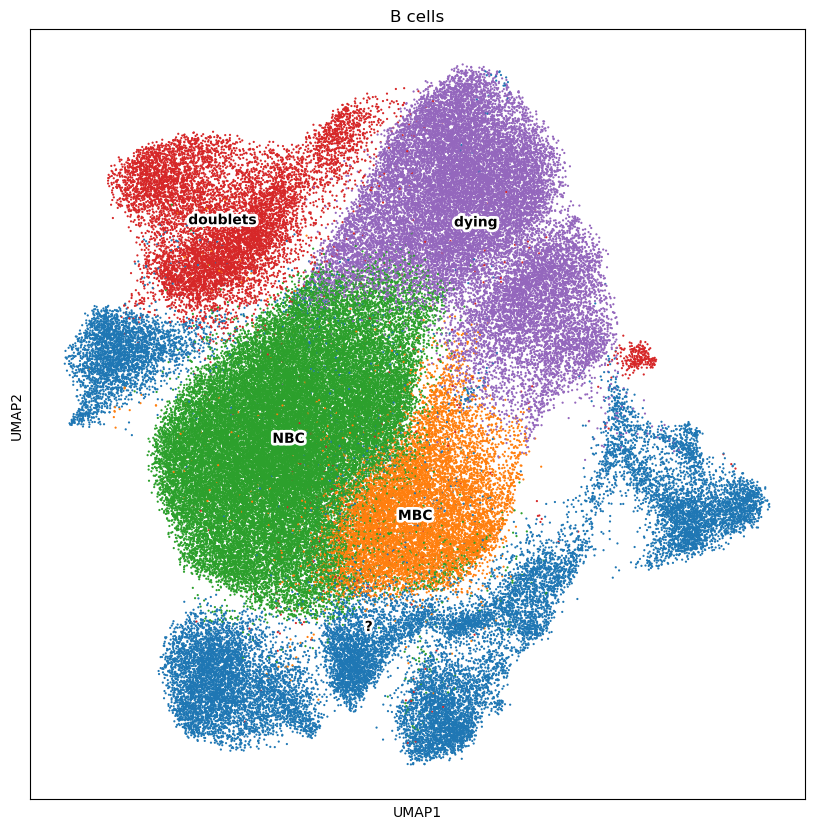

In [103]:
adata_B = update_labels(adata_B,b_dict)
fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_B, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='B cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/B_clusters_dirty.svg', format='svg')
fig.savefig('../figures/B_clusters_dirty.png', format='png', dpi=600)

plt.show()

In [104]:
adata_B_clean = adata_B.copy()
adata_B_clean=adata_B_clean[-adata_B_clean.obs['minor_cell_type'].isin(['?','low quality','trash','dying','doublets'])]

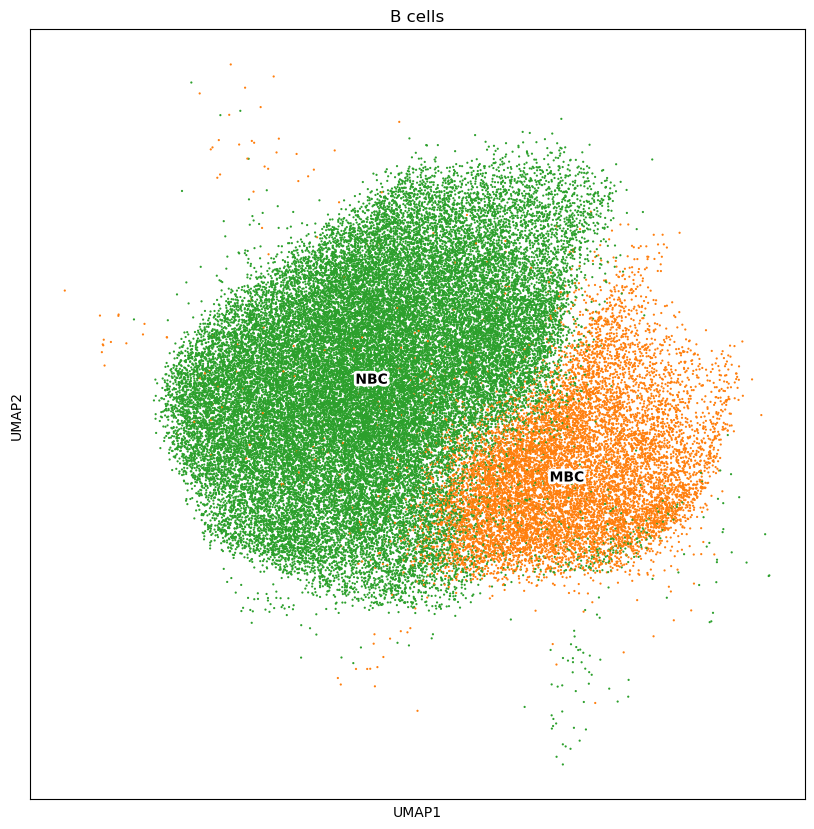

In [105]:
fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_B_clean, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='B cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/B_clusters_clean.svg', format='svg')
fig.savefig('../figures/B_clusters_clean.png', format='png', dpi=600)

plt.show()

In [106]:
b_marker = {
    'NBC': ['MS4A1', 'IL4R', 'SELL', 'IGHD'],
    'MBC': ['CD27', 'TNFRSF13B', 'IGHM', 'IGHG1', 'IGHA1']
}

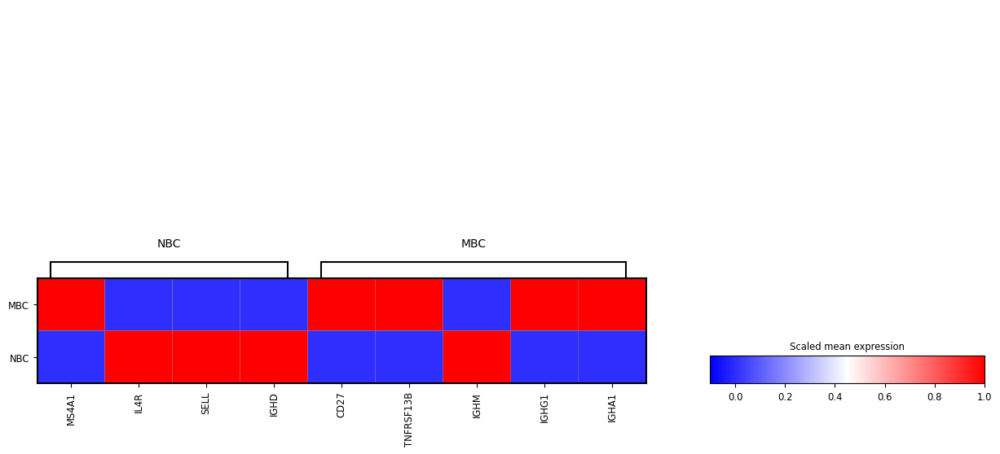

In [107]:
sc.tl.dendrogram(adata_B_clean, groupby='minor_cell_type')

fig, ax=plt.subplots(1,1,figsize=(15,6))

sc.pl.matrixplot(
    adata_B_clean,
    b_marker,
    groupby='minor_cell_type',
    standard_scale='var',
    vmin=-.1,
    vmax=1,
    cmap="bwr",
    colorbar_title='Scaled mean expression',
    dendrogram=True,
    show=False,
    ax=ax)

fig.savefig('../figures/B_heatmap_clean.svg', format='svg')
fig.savefig('../figures/B_heatmap_clean.png', format='png', dpi=600)
plt.show()

In [108]:
t_marker = {
    'CD4+ TN/TCM': ['CD3D', 'CD4', 'CCR7', 'IL7R'],
    'GZMK+ CD8+ TEM': ['CD8B', 'GZMK'],
    'GZMB+ CD8+ TEM': ['GZMB', 'FCGR3A', 'PRF1', 'GNLY'],
    'IFN+ T': ['IFIT1', 'IFIT2', 'IFIT3', 'MX1', 'ISG15', 'IFI44L'],
    'NK': ['NKG7']
}

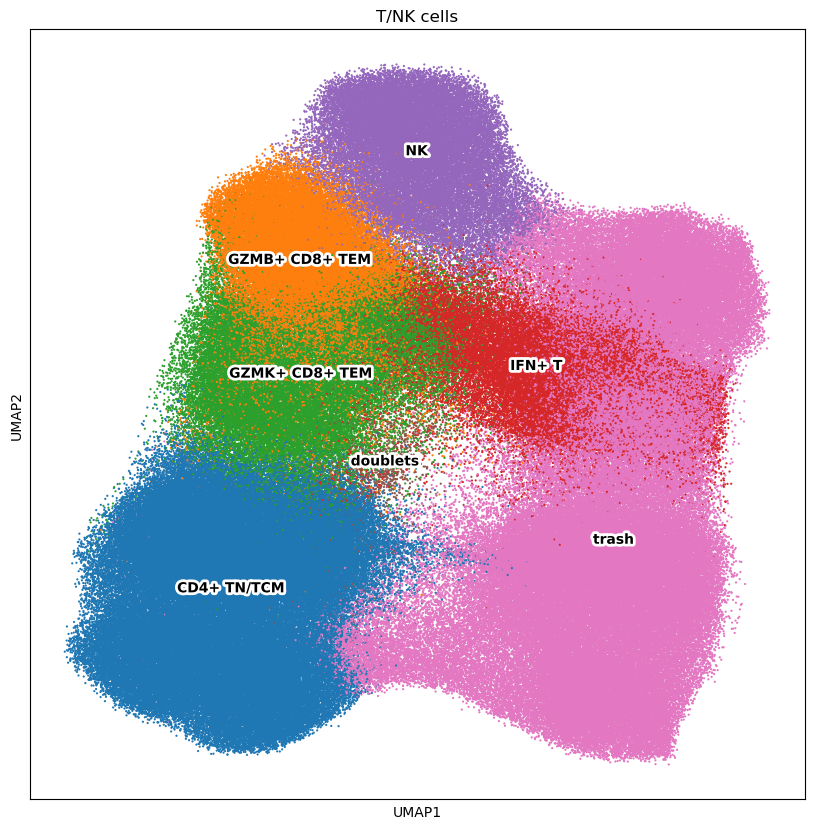

In [109]:

adata_T = update_labels(adata_T,t_dict)
fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_T, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='T/NK cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/T_clusters_dirty.svg', format='svg')
fig.savefig('../figures/T_clusters_dirty.png', format='png', dpi=600)

plt.show()

In [110]:
adata_T_clean = adata_T.copy()
adata_T_clean=adata_T_clean[-adata_T_clean.obs['minor_cell_type'].isin(['?','low quality','trash','dying','doublets'])]

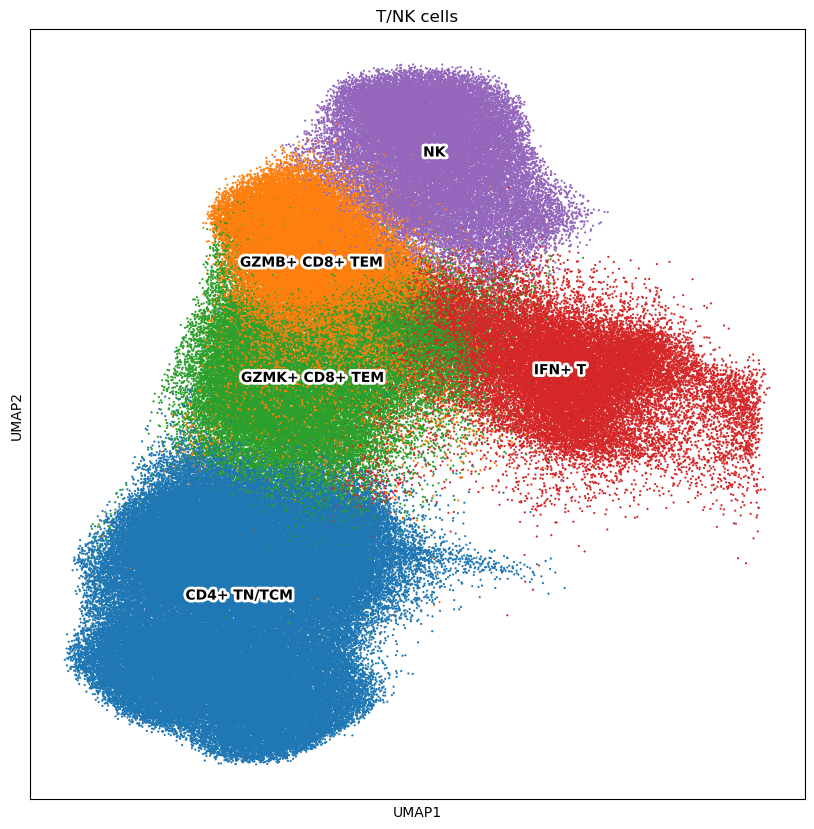

In [111]:
fig,ax=plt.subplots(1,1,figsize=(10,10))
sc.pl.umap(adata_T_clean, 
           color='minor_cell_type',
           legend_loc='on data',
           legend_fontweight='heavy',
           legend_fontoutline=4,
           size=10,
           title='T/NK cells',
           frameon=True,
           add_outline=False,
           ax=ax,
           show=False)




fig.savefig('../figures/T_clusters_clean.svg', format='svg')
fig.savefig('../figures/T_clusters_clean.png', format='png', dpi=600)

plt.show()

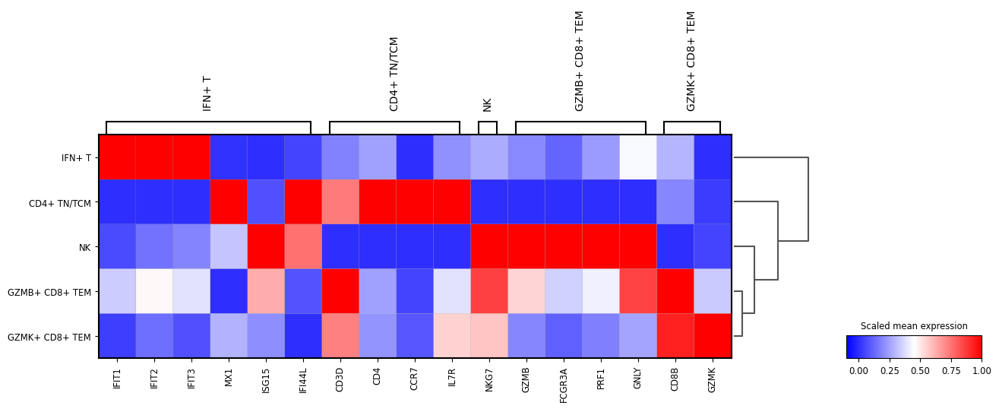

In [112]:
sc.tl.dendrogram(adata_T_clean, groupby='minor_cell_type')

fig, ax=plt.subplots(1,1,figsize=(15,6))

sc.pl.matrixplot(
    adata_T_clean,
    t_marker,
    groupby='minor_cell_type',
    standard_scale='var',
    vmin=-.1,
    vmax=1,
    cmap="bwr",
    colorbar_title='Scaled mean expression',
    dendrogram=True,
    show=False,
    ax=ax)

fig.savefig('../figures/T_heatmap_clean.svg', format='svg')
fig.savefig('../figures/T_heatmap_clean.png', format='png', dpi=600)
plt.show()

In [117]:
adata_unclassified.obs['minor_cell_type']=adata_unclassified.obs['major_cell_type']

In [113]:
adata = sc.read('../out/single_cell_object/adata_clean_major_cluster.h5ad')

In [129]:
minor_labels = pd.concat([adata_mono.obs['minor_cell_type'],
               adata_B.obs['minor_cell_type'],
               adata_T.obs['minor_cell_type'],
               adata_unclassified.obs['minor_cell_type']])

In [133]:
minor_labels = minor_labels.reindex(adata.obs_names)
adata.obs['minor_cell_type'] = minor_labels

In [135]:
adata.obs['minor_cell_type'].unique()

array(['CD16+ Mono', 'cDC2', 'CD4+ TN/TCM', 'CD14+ Mono', 'doublets',
       'MBC', 'Unclassified', 'dying', 'GZMB+ CD8+ TEM', 'GZMK+ CD8+ TEM',
       'NK', 'NBC', '?', 'trash', 'IFN+ T', 'Stem', 'low quality',
       'IL1B+ Mono', 'cDC1', 'IFN+ Mono'], dtype=object)

In [138]:
adata_clean = adata.copy()
adata_clean=adata_clean[-adata_clean.obs['minor_cell_type'].isin(['?','low quality','trash','dying','doublets','Unclassified'])]
adata_clean.write('../out/single_cell_object/adata_clean_minor_labels.h5ad')
adata.write('../out/single_cell_object/adata_dirty_minor_labels.h5ad')

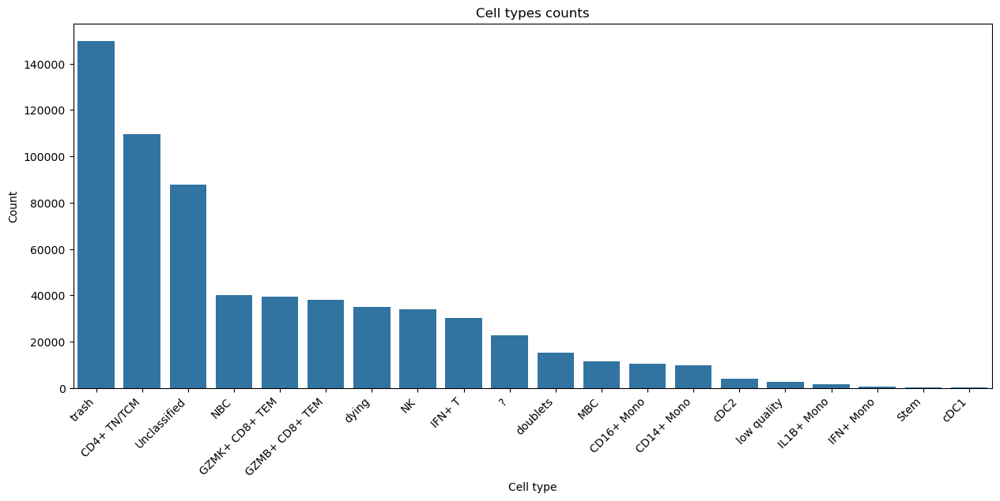

In [140]:
df = adata.obs['minor_cell_type'].value_counts().reset_index()
df.to_csv('../out/tables/minor_labels_counts_dirty.csv')



plt.figure(figsize=(15,6))
sns.barplot(data=df, x='minor_cell_type', y='count',order=df.sort_values(by='count',ascending=False)['minor_cell_type'])
plt.title('Cell types counts')
plt.xlabel('Cell type')
plt.ylabel('Count')
plt.xticks(rotation=45,ha='right')
fig.savefig('../figures/cell_counts_dirty.svg', format='svg')
fig.savefig('../figures/cell_counts_dirty.png', format='png', dpi=600)
plt.show()

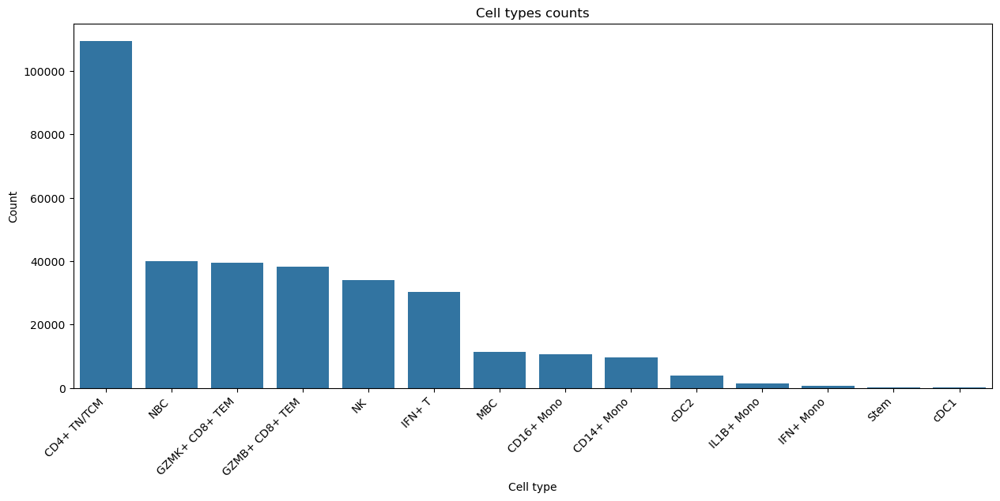

In [141]:
df = adata_clean.obs['minor_cell_type'].value_counts().reset_index()
df.to_csv('../out/tables/minor_labels_counts_clean.csv')



plt.figure(figsize=(15,6))
sns.barplot(data=df, x='minor_cell_type', y='count',order=df.sort_values(by='count',ascending=False)['minor_cell_type'])
plt.title('Cell types counts')
plt.xlabel('Cell type')
plt.ylabel('Count')
plt.xticks(rotation=45,ha='right')
fig.savefig('../figures/cell_counts_clean.svg', format='svg')
fig.savefig('../figures/cell_counts_clean.png', format='png', dpi=600)
plt.show()

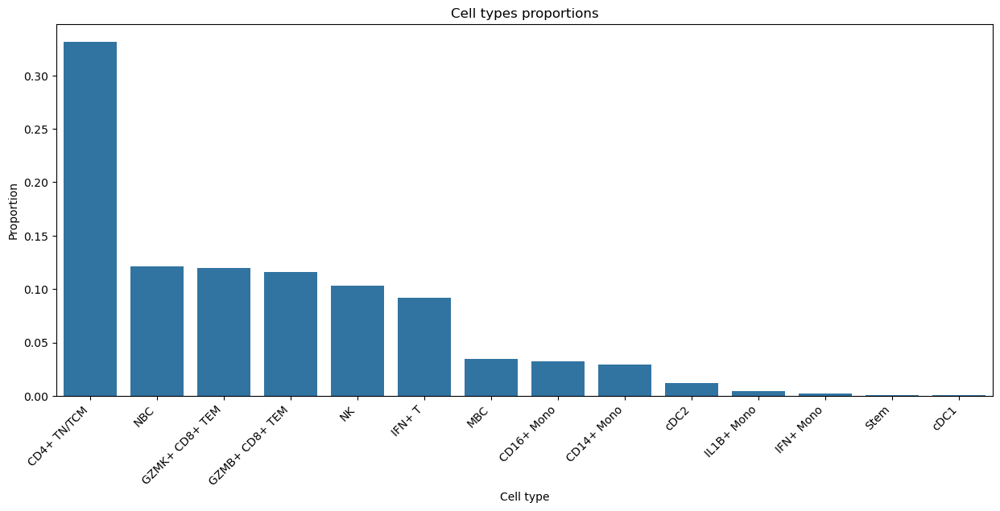

In [144]:
df = pd.DataFrame(adata_clean.obs['minor_cell_type'].value_counts()/adata_clean.obs['minor_cell_type'].value_counts().sum()).reset_index()
df.to_csv('../out/tables/minor_labels_props_clean.csv')

plt.figure(figsize=(15,6))
sns.barplot(data=df, x='minor_cell_type', y='count',order=df.sort_values(by='count',ascending=False)['minor_cell_type'])
plt.title('Cell types proportions')
plt.xlabel('Cell type')
plt.ylabel('Proportion')
plt.xticks(rotation=45,ha='right')
fig.savefig('../figures/cell_props_clean.svg', format='svg')
fig.savefig('../figures/cell_props_clean.png', format='png', dpi=600)
plt.show()

In [142]:

doublets = adata.copy()
doublets=doublets[doublets.obs['minor_cell_type']=='doublets']

doublets.write('../out/single_cell_object/adata_doublets.h5ad')

# 